# MODEL DEFINATIONS

In [18]:
from torch import nn

class ResidualBlock(nn.Module):
      def __init__(self):
        super(ResidualBlock, self).__init__()

        self.network = nn.Sequential(
            nn.Conv2d(in_channels = 256, out_channels = 256, padding = 1 , kernel_size = 3),
            nn.InstanceNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(in_channels = 256, out_channels = 256, padding = 1 , kernel_size = 3),
            nn.InstanceNorm2d(256)
        )

      def forward(self, x):
          return x +  self.network(x)

In [19]:
class Generator(nn.Module):

      def __init__(self):
        super(Generator, self).__init__()

        self.encoder = nn.Sequential(
           nn.Conv2d(in_channels = 3,   out_channels = 64,  kernel_size = 7, padding = 3, stride = 1),
           nn.InstanceNorm2d(64),
           nn.ReLU(True),

           nn.Conv2d(in_channels = 64,  out_channels = 128, kernel_size = 3, padding = 1, stride = 2),
           nn.InstanceNorm2d(128),
           nn.ReLU(True),

           nn.Conv2d(in_channels = 128, out_channels = 256, kernel_size = 3, padding = 1, stride = 2),
           nn.InstanceNorm2d(256),
           nn.ReLU(True),
        )

        self.transformer = nn.Sequential(
          ResidualBlock(),
          ResidualBlock(),
          ResidualBlock(),
          ResidualBlock(),
          ResidualBlock(),
          ResidualBlock()
        )

        self.decoder = nn.Sequential(
          nn.ConvTranspose2d(in_channels = 256, out_channels = 128, stride = 2, kernel_size = 3, padding = 1, output_padding = 1 ),
          nn.ConvTranspose2d(in_channels = 128, out_channels = 64,  stride = 2, kernel_size = 3, padding = 1, output_padding = 1 ),
          nn.ConvTranspose2d(in_channels = 64,  out_channels = 3,   stride = 1, kernel_size = 7, padding = 3),
          nn.Tanh()

        )

      def forward(self, x):
          x = self.encoder(x)
          x = self.transformer(x)
          x = self.decoder(x)
          return x


In [20]:
class Discriminator(nn.Module):
      def __init__(self):
        super(Discriminator, self).__init__()

        self.network = nn.Sequential(
            nn.Conv2d(in_channels = 3,   out_channels = 64, stride = 2, kernel_size = 4,  padding = 1),
            nn.LeakyReLU(0.2),

            nn.Conv2d(in_channels = 64,  out_channels = 128, stride = 2, kernel_size = 4,  padding = 1),
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2),


            nn.Conv2d(in_channels = 128, out_channels = 256, stride = 2, kernel_size = 4,  padding = 1),
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2),

            nn.Conv2d(in_channels = 256, out_channels = 512, stride = 1, kernel_size=4, padding = 1 ),
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2),

            nn.Conv2d(in_channels = 512, out_channels = 1,   stride = 1, kernel_size=4,  padding = 1),
            nn.Flatten()
        )

      def forward(self, x):
          return self.network(x)


In [21]:
class GANS_LOSS(nn.Module):

    def __init__(self):
      super(GANS_LOSS, self).__init__()
      self.loss = nn.MSELoss()

      self.register_buffer('real_label', torch.tensor(1.0))
      self.register_buffer('fake_label', torch.tensor(0.0))

    def get_target_tensor(self, target_is_real, prediction):
        tgt = self.real_label if target_is_real else self.fake_label
        return tgt.expand_as(prediction)


    def __call__(self, prediction,  is_target_real : bool):

        return self.loss(prediction, self.get_target_tensor(is_target_real, prediction))


In [22]:
import torch
from torch.nn import BCELoss
from torch.optim import Adam
import itertools


class CycleGans(nn.Module):

    def __init__(self, is_train : bool = False):
        super(CycleGans, self).__init__()

        self.is_train = is_train

        self.G_Anet = Generator()
        self.G_Bnet = Generator()

        self.lambda_cycle = 10.0
        self.lambda_idt = 0.5

        # if is_train then create the Discriminator
        if is_train:
          self.D_Anet = Discriminator()
          self.D_Bnet = Discriminator()

        # if is_train then define optimizer and loss etc
        if is_train:
          # same criterian for generator and discriminators (using here Wasserstein distance i.e discriminator want
          # to maximize the distance between the number predicted for real and fake).  i.e maximixe ( D(x_fake) - D(x_real) )

          # generator want to maximize the number predicted by discriminator i.e  maximixe ( D(x_fake))
          # so that distance between number for real and fake become minimum

          self.criterion_gan  = GANS_LOSS()

          ## cycle consistency loss
          self.criterion_cycle = torch.nn.L1Loss()

          # identity loss
          self.criterion_idt = torch.nn.L1Loss()

          self.optimizer_D = Adam(itertools.chain(self.D_Anet.parameters(), self.D_Bnet.parameters()), lr=0.0002, betas=(0.5, 0.999))
          self.optimizer_G = Adam(itertools.chain(self.G_Anet.parameters(), self.G_Bnet.parameters()), lr=0.0002, betas=(0.5, 0.999))

    def forward(self, x_A, x_B):

        fake_B = self.G_Anet(x_A)
        fake_A = self.G_Bnet(x_B)
        rec_A = self.G_Bnet(fake_B)
        rec_B = self.G_Anet(fake_A)

        return fake_B, fake_A, rec_A, rec_B

    def backward_G(self, pred_D_Anet_fake, pred_D_Bnet_fake, rec_A, rec_B, x_A, x_B):

        # loss for generator A
        loss_G_Anet = self.criterion_gan(pred_D_Anet_fake, True)

        # loss of generator B
        loss_G_Bnet = self.criterion_gan(pred_D_Bnet_fake, True)

        # reconstruction loss
        re_cons_loss = self.criterion_cycle(rec_A, x_A) + self.criterion_cycle(rec_B, x_B)

        # identity loss of generator A
        identity_loss_A = self.criterion_idt(self.G_Anet(x_B), x_B)

        # identity loss of generator B
        identity_loss_B = self.criterion_idt(self.G_Bnet(x_A), x_A)

        # total identity loss
        identity_loss_total =  identity_loss_A + identity_loss_B

        loss_G = loss_G_Anet + loss_G_Bnet + self.lambda_cycle * re_cons_loss + self.lambda_idt * (identity_loss_A + identity_loss_B)
        loss_G.backward()
        return loss_G.detach()

    def backward_D(self, pred_real, pred_fake):
          loss_real = self.criterion_gan(pred_real, True)
          loss_fake = self.criterion_gan(pred_fake, False)
          loss_D = 0.5 * (loss_real + loss_fake)
          loss_D.backward()
          return loss_D.detach()


    def optimize_model(self, x_A, x_B):
          # forward pass (fakes without detach for generator update)
          fake_B, fake_A, rec_A, rec_B = self.forward(x_A, x_B)

          # --- Update Generators ---
          self.optimizer_G.zero_grad()
          pred_D_Anet_forG = self.D_Anet(fake_B)
          pred_D_Bnet_forG = self.D_Bnet(fake_A)
          loss_G = self.backward_G(pred_D_Anet_forG, pred_D_Bnet_forG, rec_A, rec_B, x_A, x_B)
          self.optimizer_G.step()

          # --- Update Discriminators (use detached fakes) ---
          self.optimizer_D.zero_grad()
          pred_D_Anet_real = self.D_Anet(x_B)
          pred_D_Anet_fake = self.D_Anet(fake_B.detach())
          loss_D_Anet = self.backward_D(pred_D_Anet_real, pred_D_Anet_fake)

          pred_D_Bnet_real = self.D_Bnet(x_A)
          pred_D_Bnet_fake = self.D_Bnet(fake_A.detach())
          loss_D_Bnet = self.backward_D(pred_D_Bnet_real, pred_D_Bnet_fake)

          self.optimizer_D.step()

          # return scalars for logging
          return loss_G.item(), ((loss_D_Anet + loss_D_Bnet) / 2.0).item(), fake_A.detach(), fake_B.detach(), rec_A.detach(), rec_B.detach()


# Training Loop

In [23]:
import kagglehub

path = kagglehub.dataset_download("almightyj/person-face-sketches")

import os
for current_dir, sub_dir , files in os.walk(path):
  print(current_dir, sub_dir)
  break

/home/cowlar/.cache/kagglehub/datasets/almightyj/person-face-sketches/versions/2 ['val', 'train', 'test']


In [24]:
path = "/home/cowlar/.cache/kagglehub/datasets/almightyj/person-face-sketches/versions/2"


In [25]:
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, transforms
import os
from PIL import Image
import random

class UnpairedImageDataset(Dataset):
    def __init__(self, root_A, root_B, transform=None):
        self.transform = transform

        self.files_A = sorted([os.path.join(root_A, f) for f in os.listdir(root_A) if f.endswith(('jpg', 'png'))])
        self.files_B = sorted([os.path.join(root_B, f) for f in os.listdir(root_B) if f.endswith(('jpg', 'png'))])

    def __len__(self):
        return max(len(self.files_A), len(self.files_B))

    def __getitem__(self, index):
        img_A = Image.open(self.files_A[index % len(self.files_A)]).convert("RGB")
        img_B = Image.open(self.files_B[random.randint(0, len(self.files_B) - 1)]).convert("RGB")

        if self.transform:
            img_A = self.transform(img_A)
            img_B = self.transform(img_B)

        return {"A": img_A, "B": img_B}


transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))

])

dataset = UnpairedImageDataset(
    root_A=f"{path}/train/photos",
    root_B=f"{path}/train/sketches",
    transform=transform
)

dataloader = DataLoader(dataset, batch_size=4, shuffle=True)


In [26]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


In [27]:
import matplotlib.pyplot as plt
import numpy as np
import torch
from torchvision.utils import make_grid, save_image
from IPython.display import display
from pathlib import Path

def denormalize(tensor):
    """Assumes input normalized to [-1,1], bring to [0,1]"""
    return (tensor * 0.5) + 0.5


def show_sample_images(real_A, real_B, fake_A, fake_B, rec_A, rec_B,
                       epoch=None, batch_idx=None, figsize=(12, 6),
                       save_to=None, show_inline=True):
    """
    Display a 2x3 grid inline in Colab:
      Row 1: real_A | fake_B (A->B) | rec_A
      Row 2: real_B | fake_A (B->A) | rec_B

    Args:
      tensors: torch.Tensor of shape [B, C, H, W], normalized to [-1,1]
      epoch, batch_idx: optional annotations appearing as title
      figsize: matplotlib figure size
      save_to: optional path to save composed grid
      show_inline: if False, returns figure instead of displaying immediately
    """
    # pick first sample in the batch for display
    samples = [
        denormalize(real_A[0].cpu()),
        denormalize(fake_B[0].cpu()),
        denormalize(rec_A[0].cpu()),
        denormalize(real_B[0].cpu()),
        denormalize(fake_A[0].cpu()),
        denormalize(rec_B[0].cpu()),
    ]

    # stack -> (6, C, H, W)
    grid_tensor = torch.stack(samples, dim=0)
    # make grid with 3 columns
    grid_for_display = make_grid(grid_tensor, nrow=3, pad_value=1.0)
    np_img = grid_for_display.permute(1, 2, 0).numpy()
    np_img = np.clip(np_img, 0.0, 1.0)

    # build figure
    fig = plt.figure(figsize=figsize)
    plt.axis('off')
    title = f"Real | Fake | Reconstructed | Epoch: {epoch}, Batch: {batch_idx}" \
        if (epoch is not None and batch_idx is not None) else ""
    if title:
        plt.title(title)
    plt.imshow(np_img)

    # show or return
    if show_inline:
        display(fig)
        plt.close(fig)
    else:
        # return the fig to the caller
        return fig

    # optionally save the image
    if save_to is not None:
        Path(save_to).parent.mkdir(parents=True, exist_ok=True)
        save_image(grid_for_display, save_to)


In [28]:
def save_checkpoint(model: CycleGans, out_dir, epoch, batch_no):
    Path(out_dir).mkdir(parents=True, exist_ok=True)
    ckpt = {
        'G_Anet': model.G_Anet.state_dict(),
        'G_Bnet': model.G_Bnet.state_dict(),
        'D_Anet': model.D_Anet.state_dict(),
        'D_Bnet': model.D_Bnet.state_dict(),
        'optim_G': model.optimizer_G.state_dict(),
        'optim_D': model.optimizer_D.state_dict(),
    }
    torch.save(ckpt, os.path.join(out_dir, f'checkpoint_epoch_{epoch:03d}_batch_{batch_no}.pth'))
    # from google.colab import files
    # files.download(f"{out_dir}/checkpoint_epoch_{epoch:03d}.pth")


In [29]:
from tqdm import tqdm
from IPython.display import display
import matplotlib.pyplot as plt

def training_loop(cycle_gans: CycleGans, dataloader: DataLoader, num_epochs: int,
                  device: str, ckpt_dir='./checkpoints',
                  save_image_every=1, print_every=50, start_epoch = 1):
    """
    Trains the CycleGAN model with tqdm progress bars for both epochs and batches.
    """
    cycle_gans.train()

    for epoch in tqdm(range(start_epoch, num_epochs + 1), desc="Training Epochs", unit="epoch"):
        epoch_bar = tqdm(enumerate(dataloader, start=1),
                         total=len(dataloader),
                         leave=False,
                         desc=f"Epoch {epoch}/{num_epochs}",
                         unit="batch")

        for batch_idx, data in epoch_bar:
            real_A = data['A'].to(device)
            real_B = data['B'].to(device)

            loss_G, loss_D, fake_A, fake_B, rec_A, rec_B = cycle_gans.optimize_model(real_A, real_B)

            # update tqdm postfix dynamically
            epoch_bar.set_postfix({
                "G_loss": f"{loss_G:.4f}",
                "D_loss": f"{loss_D:.4f}"
            })

            if batch_idx % print_every == 0 or batch_idx == 1:
                print(f"[Epoch {epoch}/{num_epochs}] [Batch {batch_idx}/{len(dataloader)}] "
                      f"G_loss: {loss_G:.4f} | D_loss: {loss_D:.4f}")

            # show images BELOW tqdm/logs (no clear_output)
            if batch_idx % 2500 == 0:
                fig = show_sample_images(
                    real_A, real_B, fake_A, fake_B, rec_A, rec_B,
                    epoch=epoch, batch_idx=batch_idx,
                    figsize=(12, 6),
                    save_to=None,
                    show_inline=False
                )
                display(fig)
                plt.close(fig)
                save_checkpoint(cycle_gans, ckpt_dir, epoch, batch_idx )


        save_checkpoint(cycle_gans, ckpt_dir, epoch, batch_no = 'last')
        print(f"Saved checkpoint for epoch {epoch} to {ckpt_dir}")


In [30]:
model = CycleGans(is_train=True).to(device)

# TRAINING FIRST ITERATIN



Stopped above just to conform the weight must be donwloaded

In [31]:
training_loop(model, dataloader, num_epochs = 2  , device=device, ckpt_dir='./checkpoints',
              save_image_every=1, print_every=1500)

Training Epochs:   0%|          | 0/2 [00:00<?, ?epoch/s]

[Epoch 1/2] [Batch 1/5164] G_loss: 20.1760 | D_loss: 0.8196


Training Epochs:   0%|          | 0/2 [00:04<?, ?epoch/s]


KeyboardInterrupt: 

## OK SO STARTING TRAINING AGAIN IN NEW COLAB ACCOUNT BECAUSE 😏

In [ ]:
import torch

def load_checkpoint(model: CycleGans, ckpt_path: str, device: str = "cuda"):
    """
    Loads full CycleGAN checkpoint — Generators, Discriminators, and Optimizers.
    """
    checkpoint = torch.load(ckpt_path, map_location=device)

    model.G_Anet.load_state_dict(checkpoint['G_Anet'])
    model.G_Bnet.load_state_dict(checkpoint['G_Bnet'])
    model.D_Anet.load_state_dict(checkpoint['D_Anet'])
    model.D_Bnet.load_state_dict(checkpoint['D_Bnet'])

    model.optimizer_G.load_state_dict(checkpoint['optim_G'])
    model.optimizer_D.load_state_dict(checkpoint['optim_D'])

    print(f"✅ Loaded full checkpoint from {ckpt_path}")


In [ ]:
load_checkpoint(model, ckpt_path='/content/checkpoint_epoch_001.pth')

✅ Loaded full checkpoint from /content/checkpoint_epoch_001.pth


Training Epochs:   0%|          | 0/3 [00:00<?, ?epoch/s]

Epoch 3/5:   0%|          | 0/2582 [00:00<?, ?batch/s]

[Epoch 3/5] [Batch 1/2582] G_loss: 2.2049 | D_loss: 0.1573


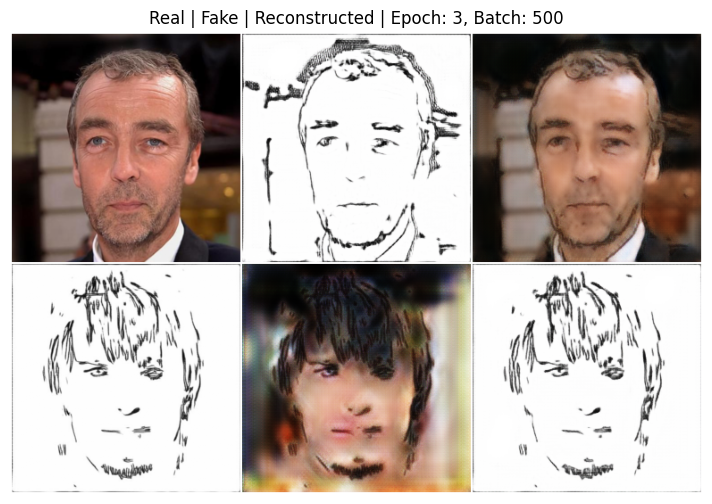

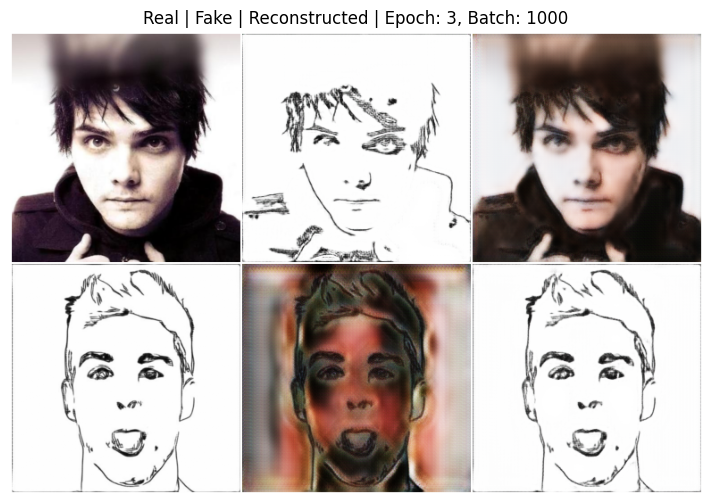

[Epoch 3/5] [Batch 1500/2582] G_loss: 2.4137 | D_loss: 0.1446


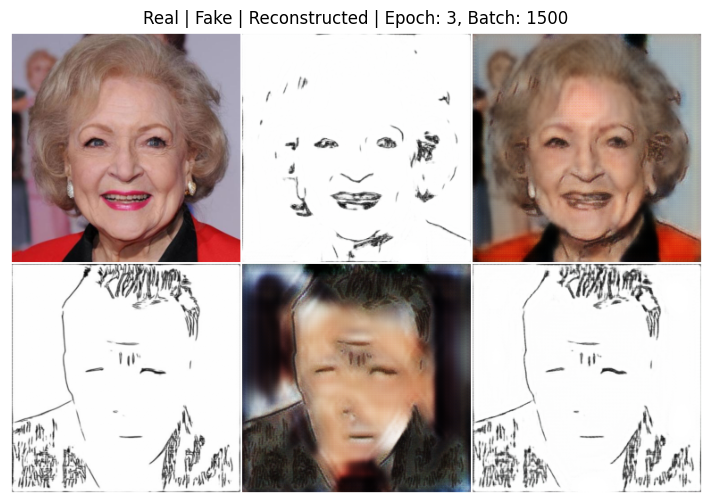

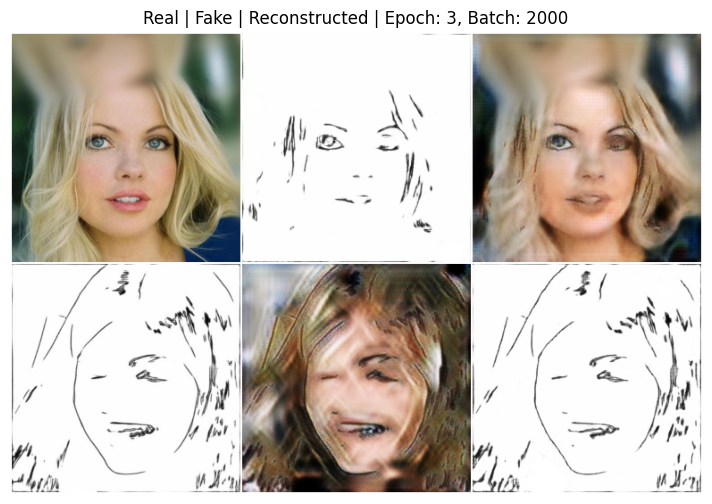

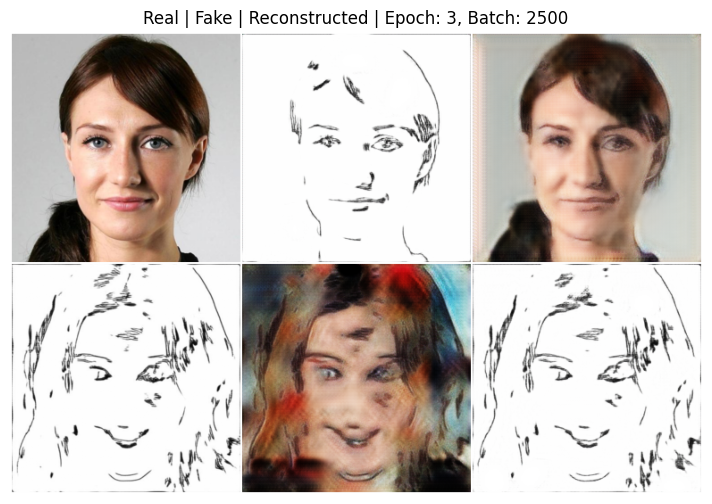

TypeError: save_checkpoint() missing 1 required positional argument: 'batch_no'

TypeError: save_checkpoint() missing 1 required positional argument: 'batch_no'

In [ ]:
training_loop(model, dataloader, num_epochs = 5  , device=device, ckpt_dir='./checkpoints',
              save_image_every=1, print_every=1500, start_epoch=3)

In [ ]:
load_checkpoint(model, ckpt_path='/home/cowlar/Downloads/checkpoint_epoch_010_batch_last.pth')

NameError: name 'load_checkpoint' is not defined

[Epoch 4/10] [Batch 1/2582] G_loss: 2.8915 | D_loss: 0.0631


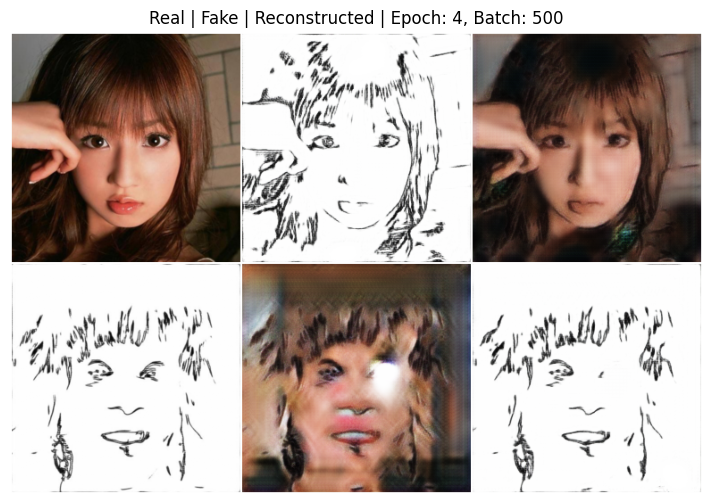

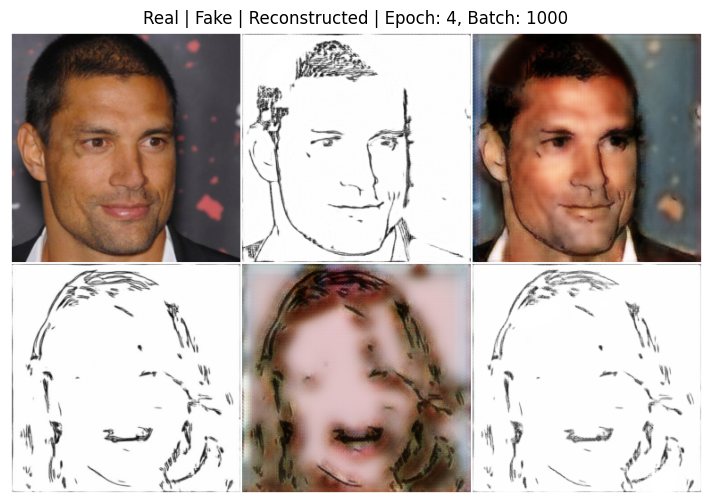

[Epoch 4/10] [Batch 1500/2582] G_loss: 2.2699 | D_loss: 0.1810


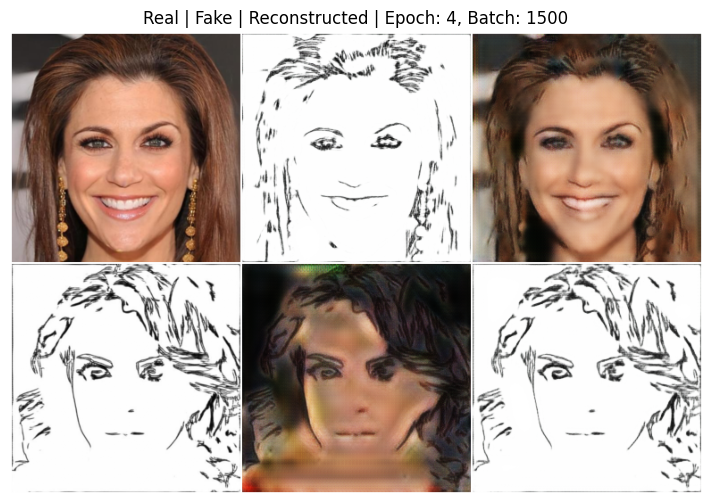

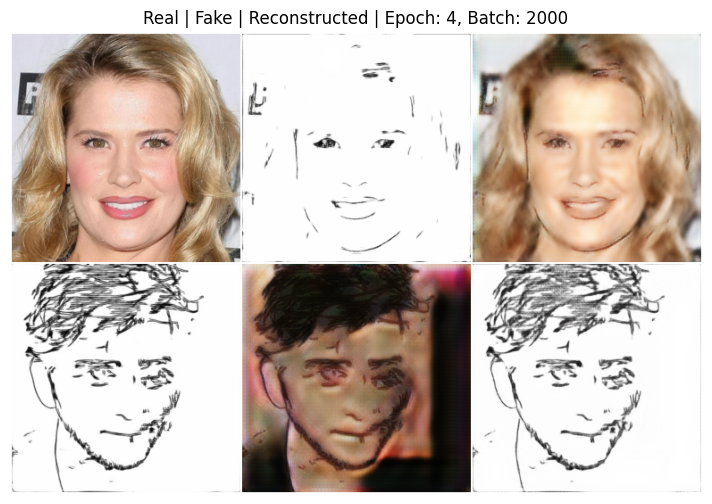

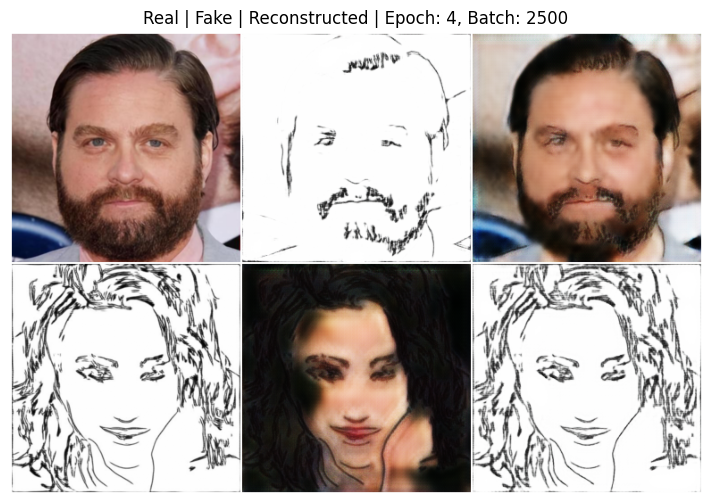

Saved checkpoint for epoch 4 to ./checkpoints


[Epoch 5/10] [Batch 1/2582] G_loss: 2.0999 | D_loss: 0.1722


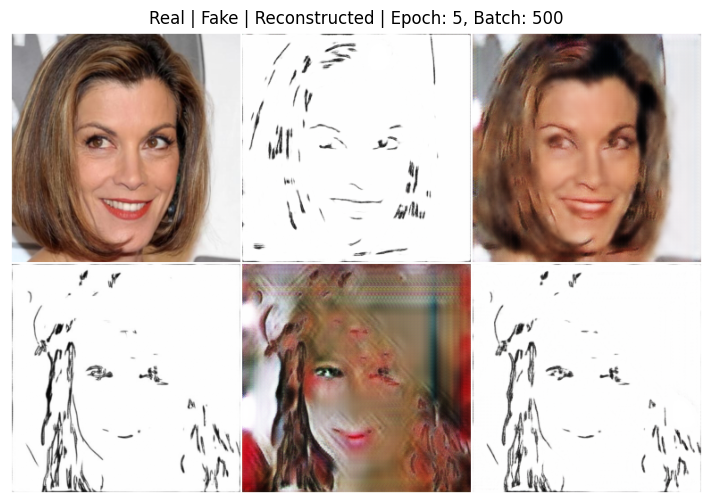

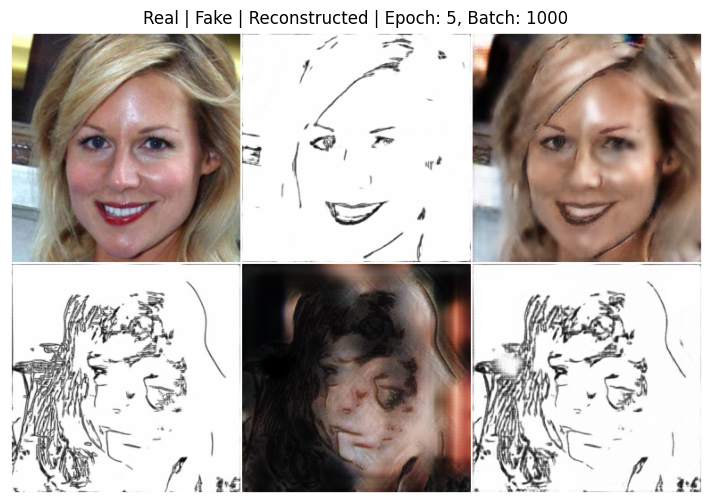

[Epoch 5/10] [Batch 1500/2582] G_loss: 3.2370 | D_loss: 0.0489


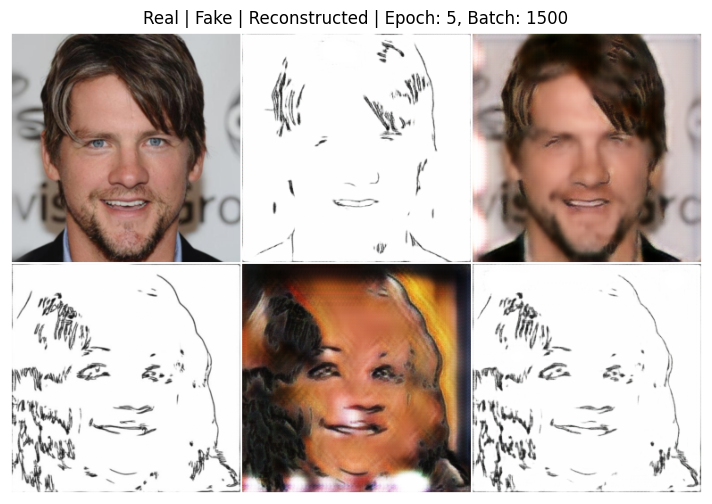

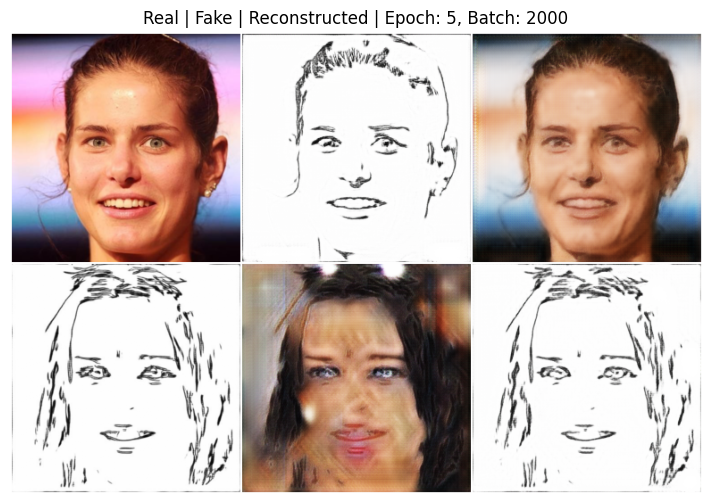

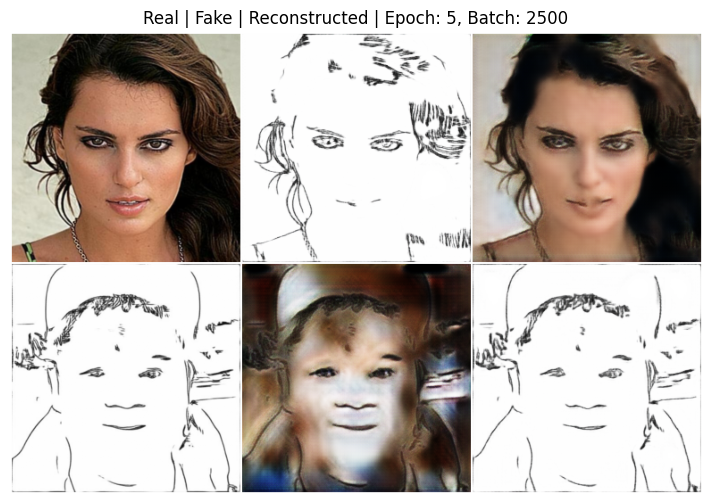

Saved checkpoint for epoch 5 to ./checkpoints


[Epoch 6/10] [Batch 1/2582] G_loss: 2.0989 | D_loss: 0.1401


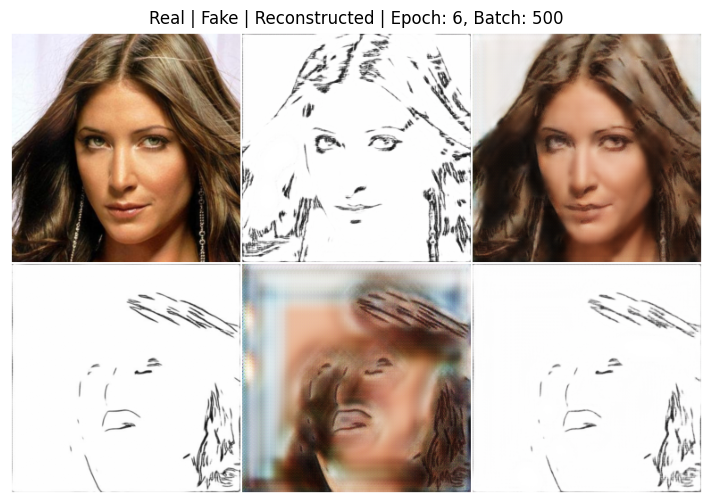

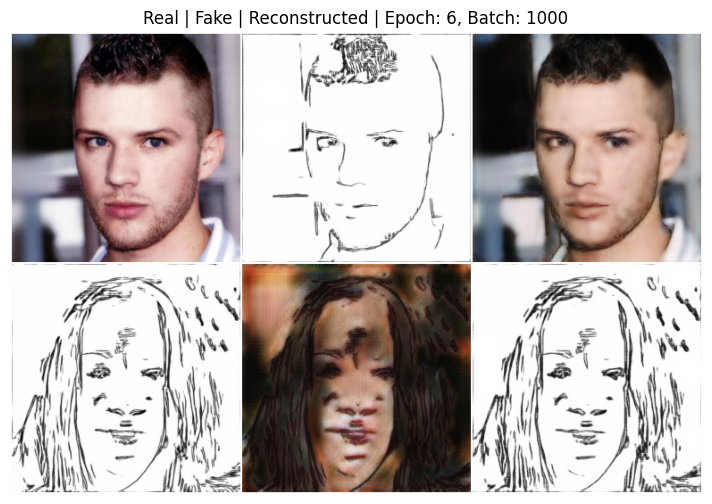

[Epoch 6/10] [Batch 1500/2582] G_loss: 2.4554 | D_loss: 0.1825


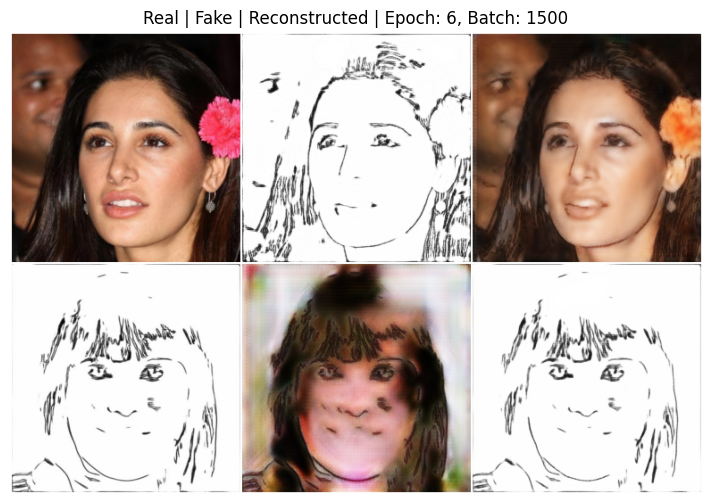

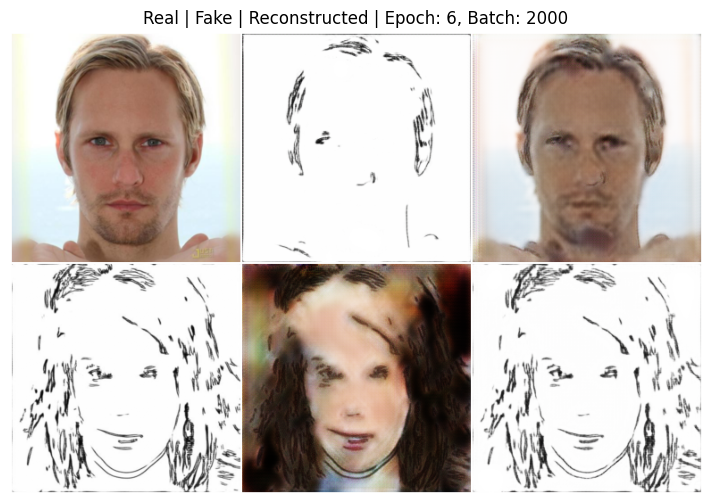

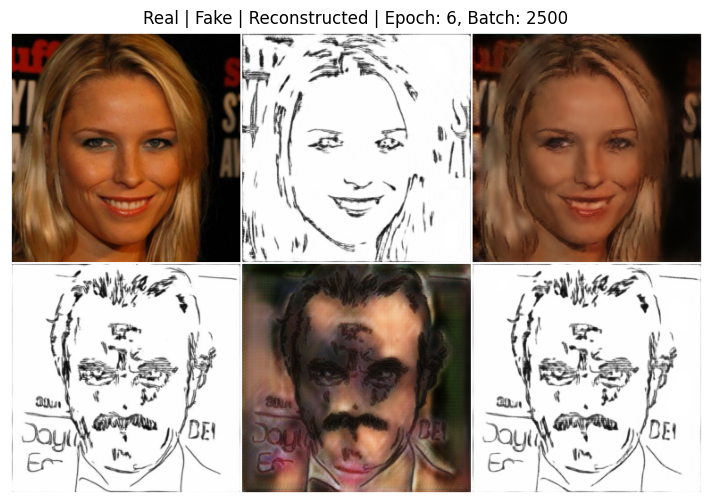

Saved checkpoint for epoch 6 to ./checkpoints


[Epoch 7/10] [Batch 1/2582] G_loss: 1.7557 | D_loss: 0.1614


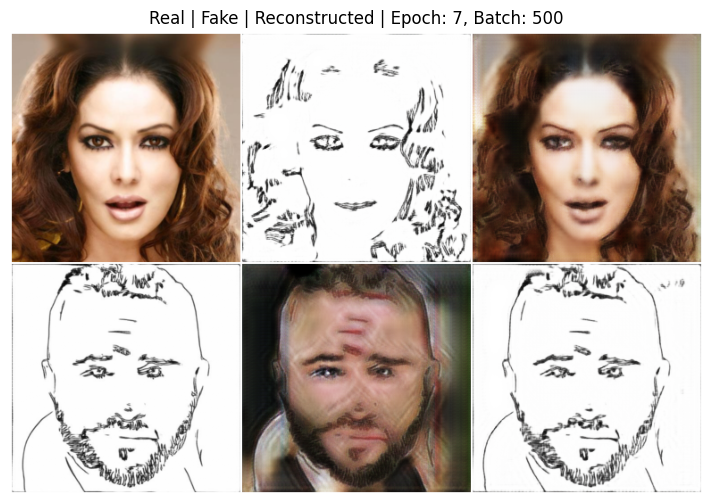

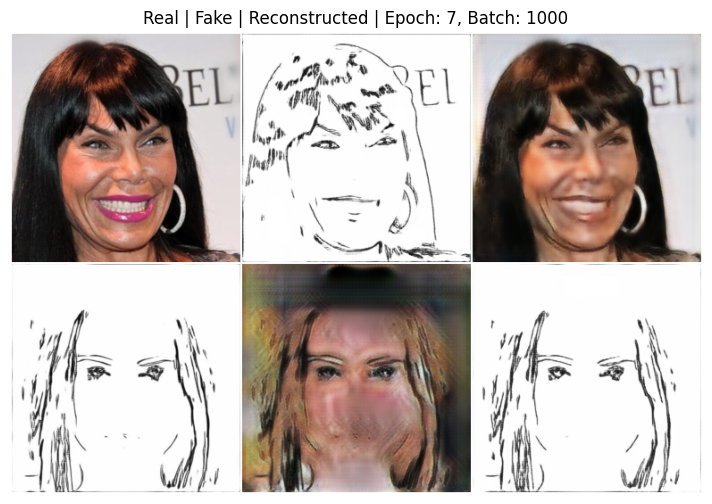

[Epoch 7/10] [Batch 1500/2582] G_loss: 2.2724 | D_loss: 0.0889


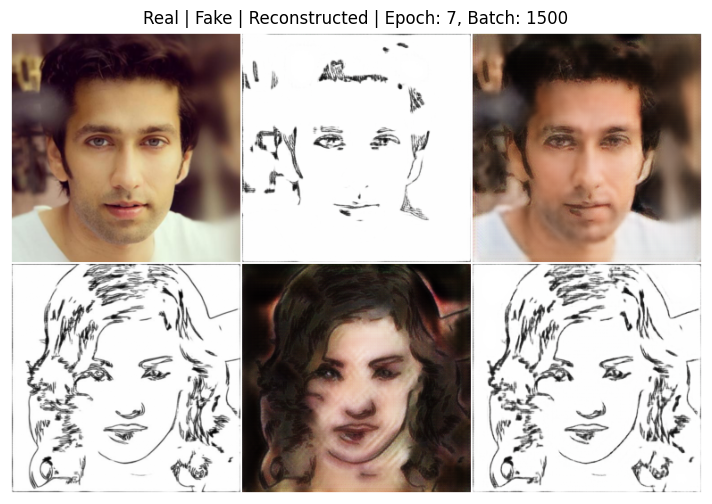

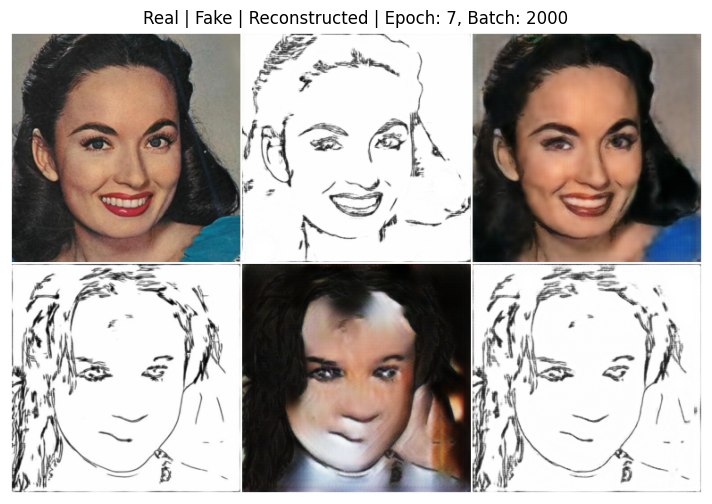

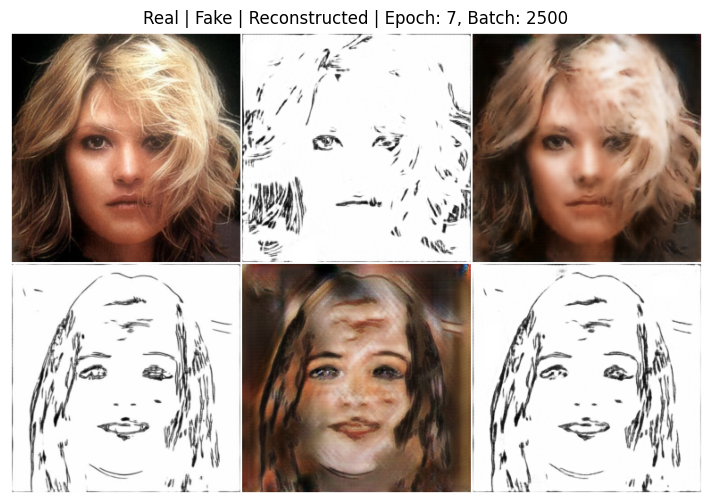

Saved checkpoint for epoch 7 to ./checkpoints


Epoch 8/10:   0%|          | 1/2582 [00:01<1:02:46,  1.46s/batch, G_loss=3.0861, D_loss=0.0419]

[Epoch 8/10] [Batch 1/2582] G_loss: 3.0861 | D_loss: 0.0419


Epoch 8/10:  19%|█▉        | 499/2582 [12:14<50:41,  1.46s/batch, G_loss=2.8486, D_loss=0.0876]  

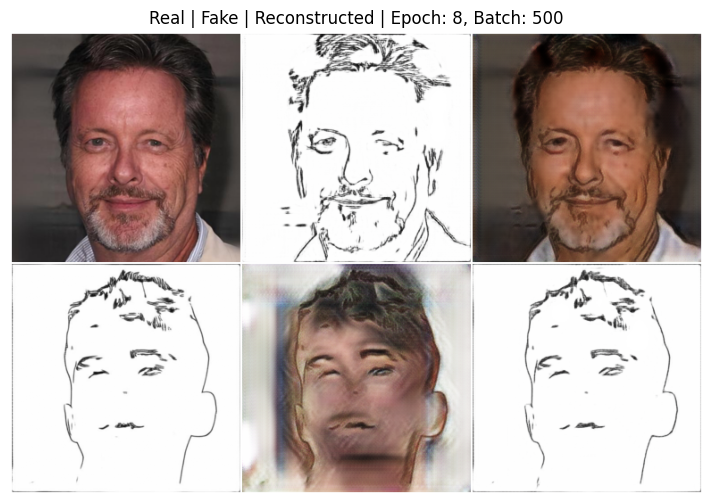

Epoch 8/10:  39%|███▊      | 999/2582 [24:29<38:44,  1.47s/batch, G_loss=2.9962, D_loss=0.0409]

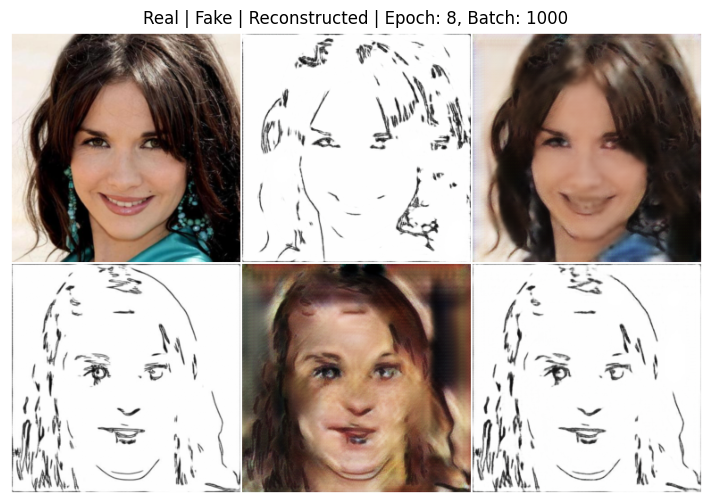

Epoch 8/10:  58%|█████▊    | 1499/2582 [36:47<27:04,  1.50s/batch, G_loss=6.2383, D_loss=0.3188]  

[Epoch 8/10] [Batch 1500/2582] G_loss: 6.2383 | D_loss: 0.3188


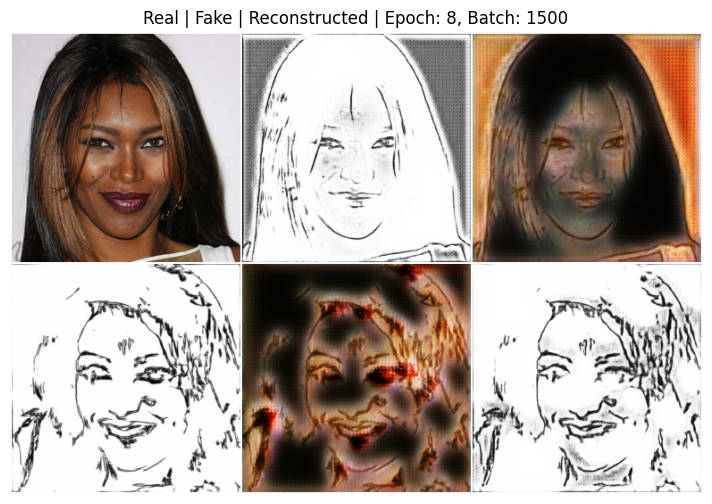

Epoch 8/10:  77%|███████▋  | 1999/2582 [49:07<14:21,  1.48s/batch, G_loss=1.5846, D_loss=0.1906]

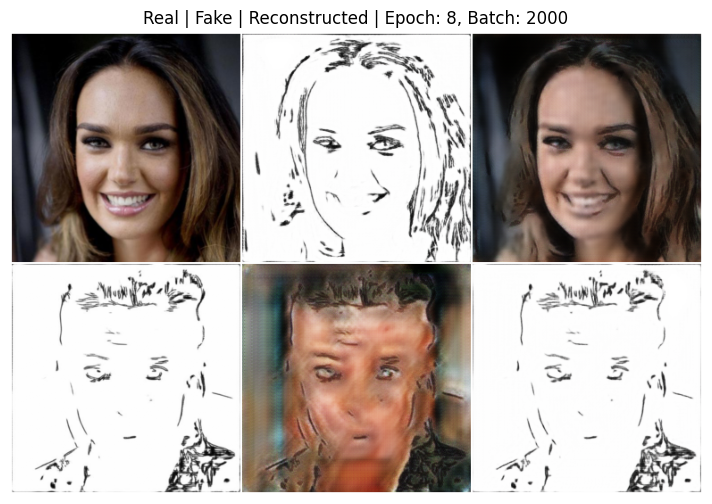

Epoch 8/10:  97%|█████████▋| 2499/2582 [1:01:28<02:02,  1.48s/batch, G_loss=3.0306, D_loss=0.1916]

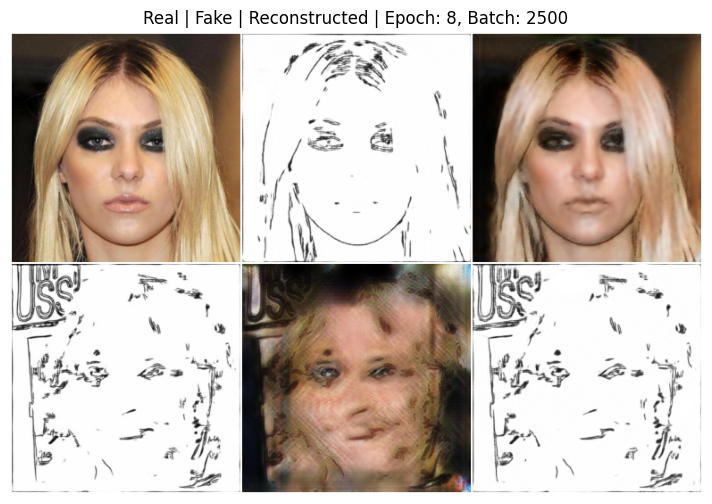

Saved checkpoint for epoch 8 to ./checkpoints


Epoch 9/10:   0%|          | 1/2582 [00:01<1:02:51,  1.46s/batch, G_loss=3.6255, D_loss=0.0259]

[Epoch 9/10] [Batch 1/2582] G_loss: 3.6255 | D_loss: 0.0259


Epoch 9/10:  19%|█▉        | 499/2582 [12:20<51:19,  1.48s/batch, G_loss=2.8518, D_loss=0.0607]  

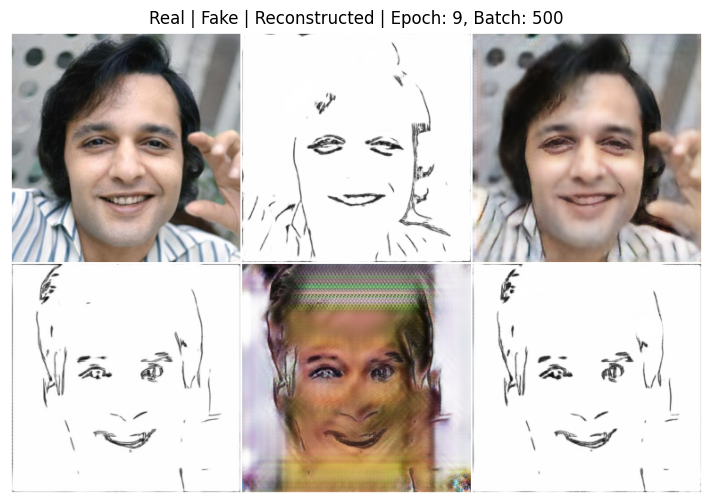

Epoch 9/10:  39%|███▊      | 999/2582 [24:54<39:36,  1.50s/batch, G_loss=2.6827, D_loss=0.0370]

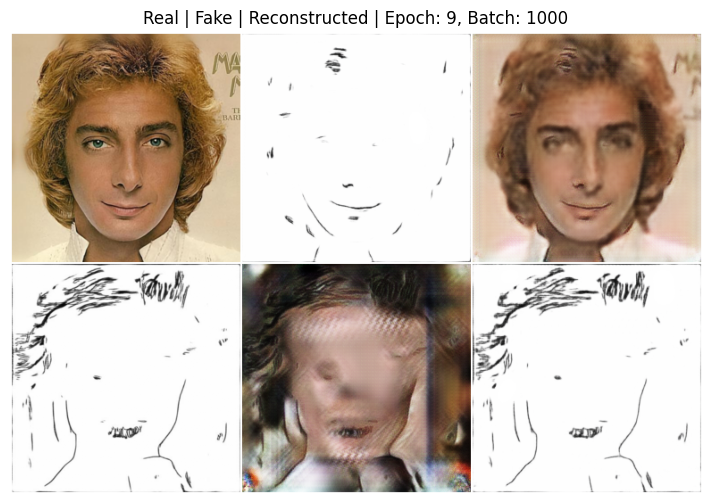

Epoch 9/10:  58%|█████▊    | 1499/2582 [37:29<26:49,  1.49s/batch, G_loss=2.7267, D_loss=0.1034]

[Epoch 9/10] [Batch 1500/2582] G_loss: 2.7267 | D_loss: 0.1034


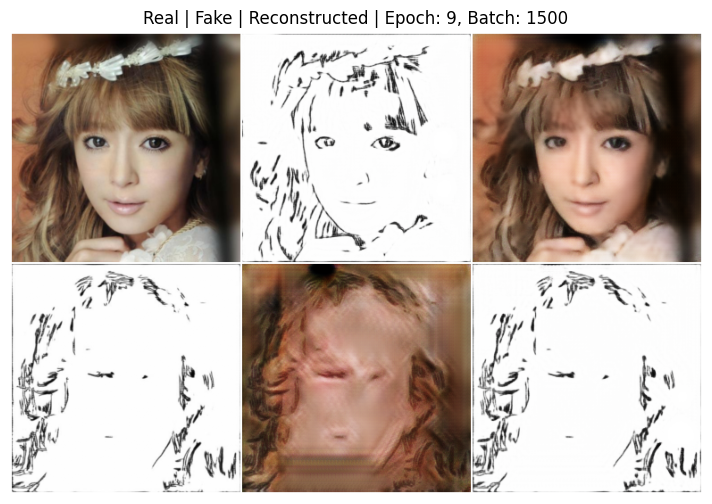

Epoch 9/10:  77%|███████▋  | 1999/2582 [50:09<14:46,  1.52s/batch, G_loss=2.1753, D_loss=0.1347] 

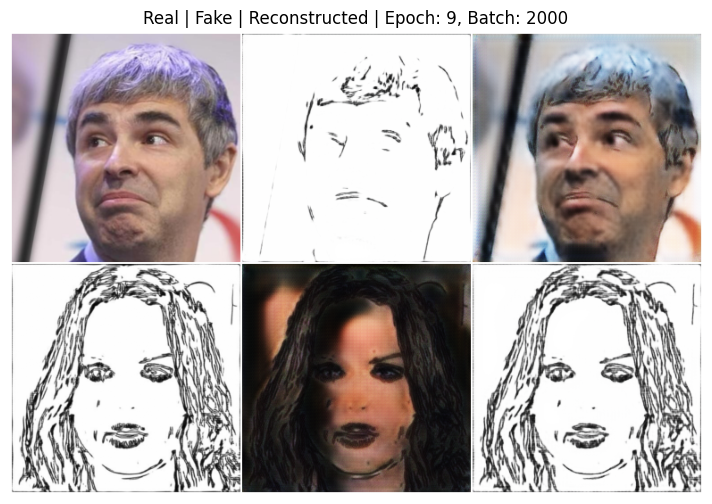

Epoch 9/10:  97%|█████████▋| 2499/2582 [1:02:57<02:04,  1.50s/batch, G_loss=3.2737, D_loss=0.0200]

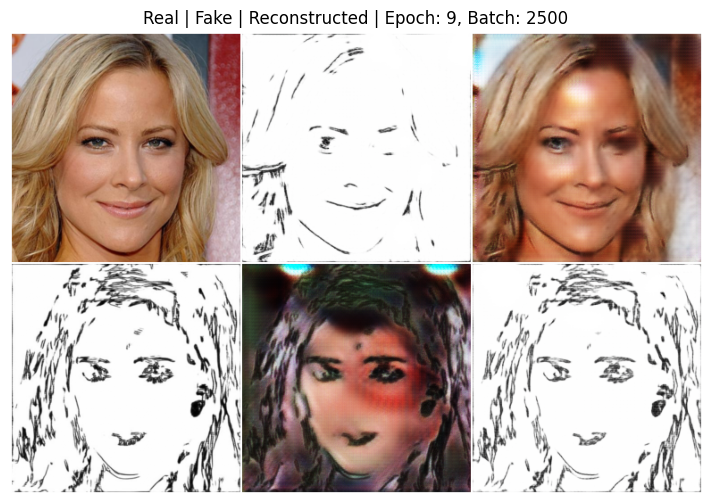

Saved checkpoint for epoch 9 to ./checkpoints


Epoch 10/10:   0%|          | 1/2582 [00:01<1:03:11,  1.47s/batch, G_loss=2.4039, D_loss=0.0889]

[Epoch 10/10] [Batch 1/2582] G_loss: 2.4039 | D_loss: 0.0889


Epoch 10/10:  19%|█▉        | 499/2582 [12:52<53:17,  1.54s/batch, G_loss=2.9347, D_loss=0.1626]  

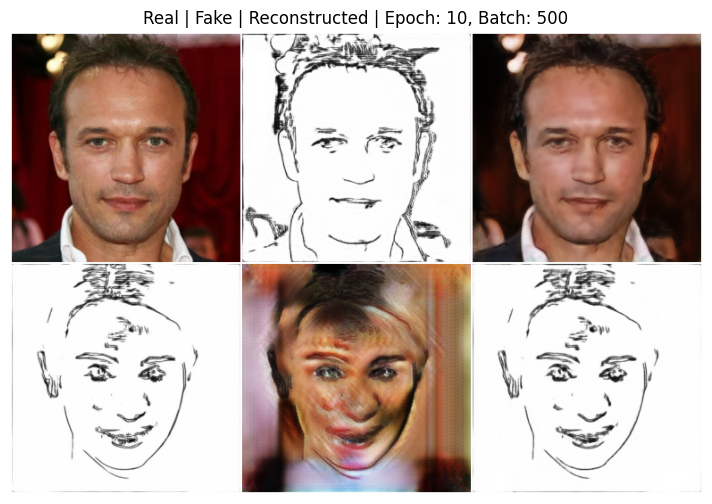

Epoch 10/10:  39%|███▊      | 999/2582 [25:50<40:48,  1.55s/batch, G_loss=2.9299, D_loss=0.0390]

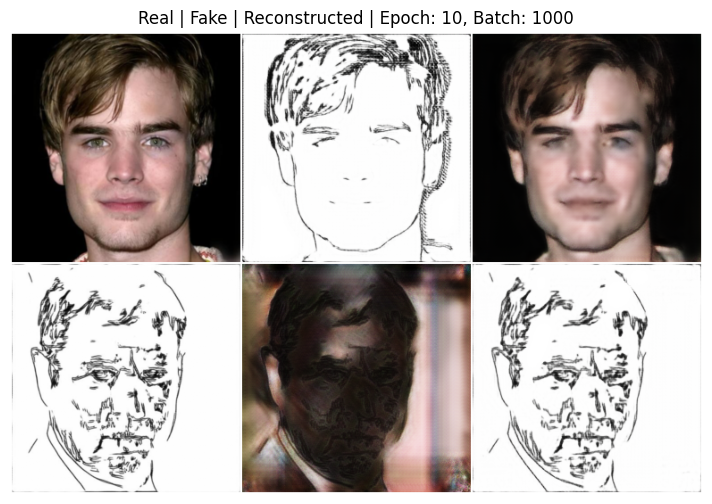

Epoch 10/10:  58%|█████▊    | 1499/2582 [38:48<27:44,  1.54s/batch, G_loss=2.8995, D_loss=0.0226]

[Epoch 10/10] [Batch 1500/2582] G_loss: 2.8995 | D_loss: 0.0226


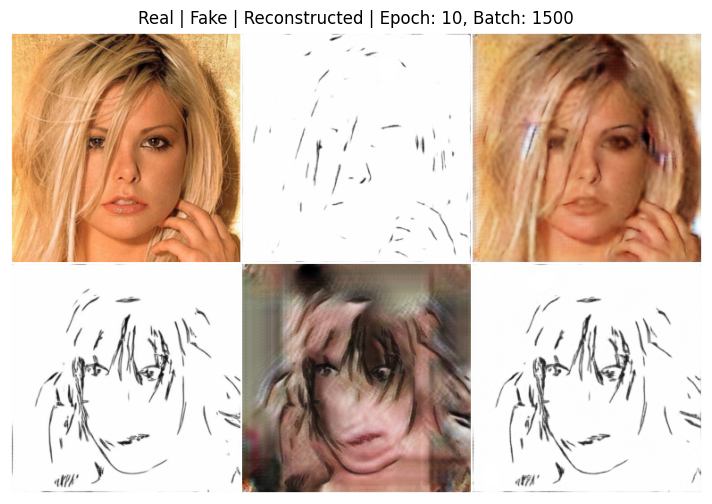

Epoch 10/10:  77%|███████▋  | 1999/2582 [51:47<14:57,  1.54s/batch, G_loss=2.5631, D_loss=0.0963]

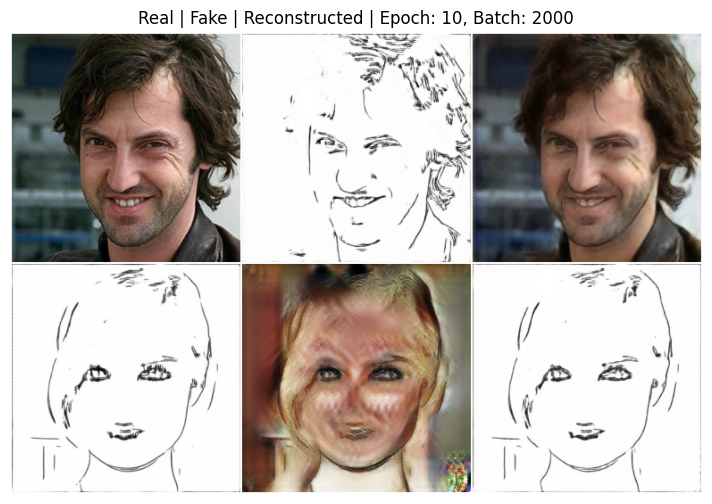

Epoch 10/10:  97%|█████████▋| 2499/2582 [1:04:47<02:08,  1.55s/batch, G_loss=2.6349, D_loss=0.0330]

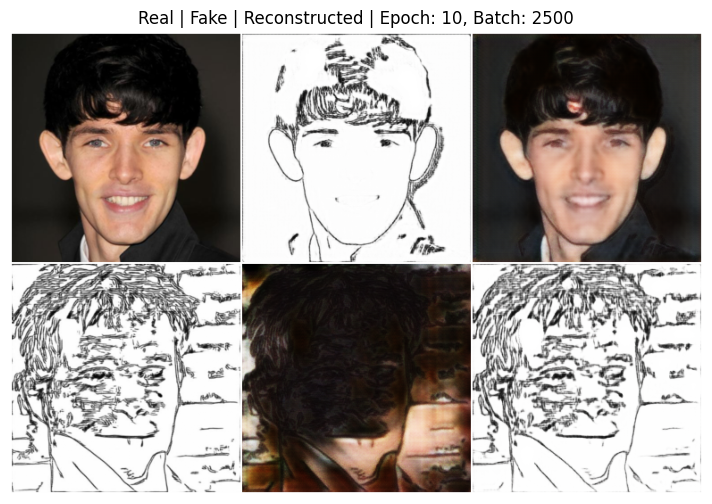

                                                                                                   
Training Epochs: 100%|██████████| 7/7 [7:28:44<00:00, 3846.42s/epoch]

Saved checkpoint for epoch 10 to ./checkpoints


In [ ]:
training_loop(model, dataloader, num_epochs = 20  , device=device, ckpt_dir='./checkpoints',
              save_image_every=1, print_every=1500, start_epoch=11)

In [ ]:
load_checkpoint(model, ckpt_path='/home/cowlar/Downloads/checkpoints/checkpoint_epoch_010_batch_last.pth')

✅ Loaded full checkpoint from /home/cowlar/Downloads/checkpoints/checkpoint_epoch_010_batch_last.pth


Training Epochs:   0%|          | 0/5 [00:00<?, ?epoch/s]

[Epoch 1/5] [Batch 1/5164] G_loss: 1.8211 | D_loss: 0.1323


[Epoch 1/5] [Batch 1500/5164] G_loss: 3.6349 | D_loss: 0.0748


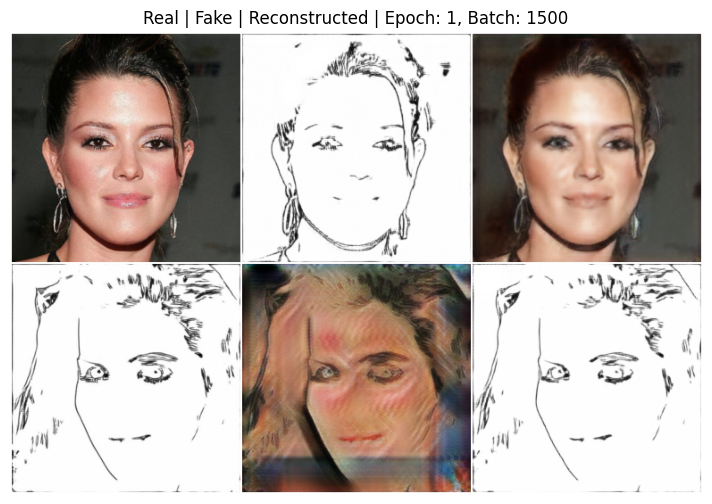

[Epoch 1/5] [Batch 3000/5164] G_loss: 3.0449 | D_loss: 0.0214


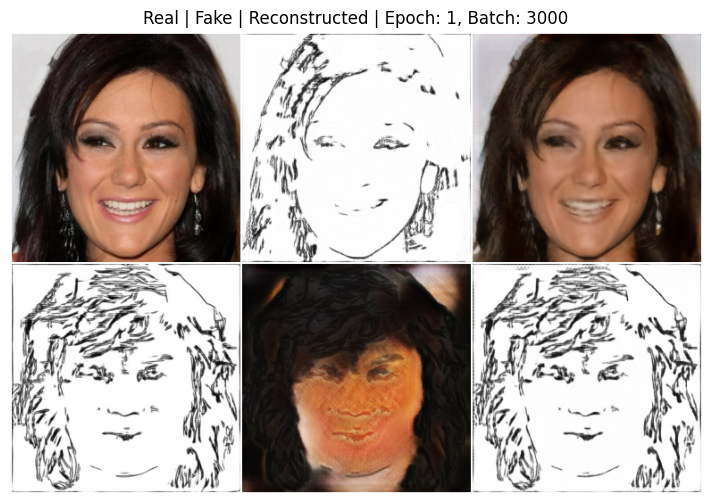

[Epoch 1/5] [Batch 4500/5164] G_loss: 2.8851 | D_loss: 0.0090


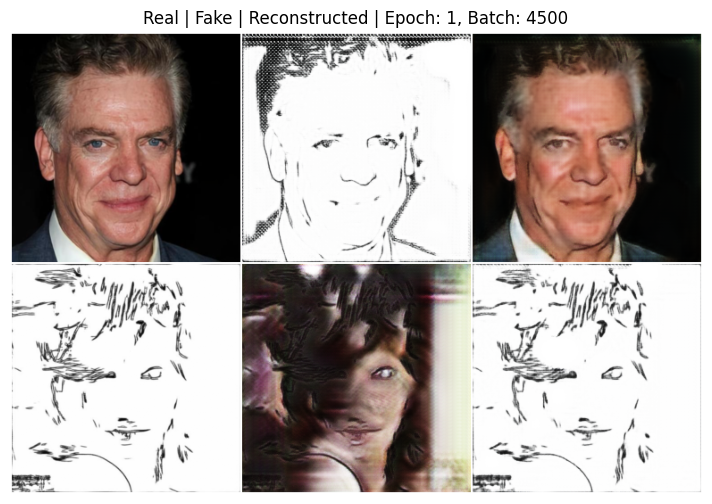

Training Epochs:  20%|██        | 1/5 [1:13:47<4:55:09, 4427.44s/epoch]

Saved checkpoint for epoch 1 to ./checkpoints


[Epoch 2/5] [Batch 1/5164] G_loss: 2.5705 | D_loss: 0.2148


[Epoch 2/5] [Batch 1500/5164] G_loss: 2.9494 | D_loss: 0.0279


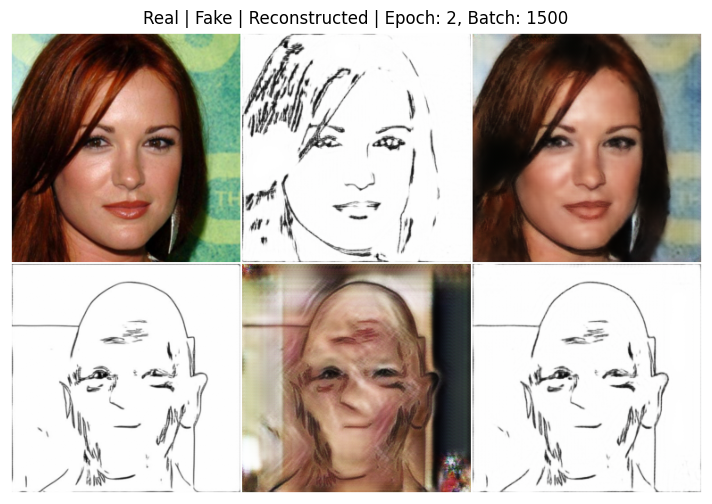

[Epoch 2/5] [Batch 3000/5164] G_loss: 3.1315 | D_loss: 0.0137


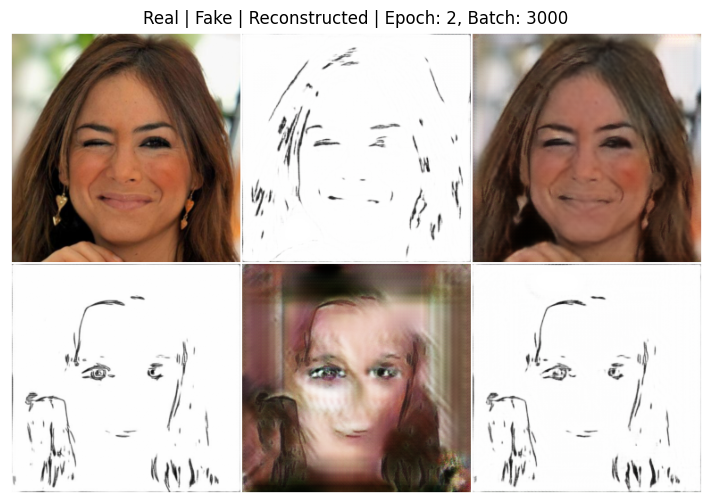

[Epoch 2/5] [Batch 4500/5164] G_loss: 2.3787 | D_loss: 0.1030


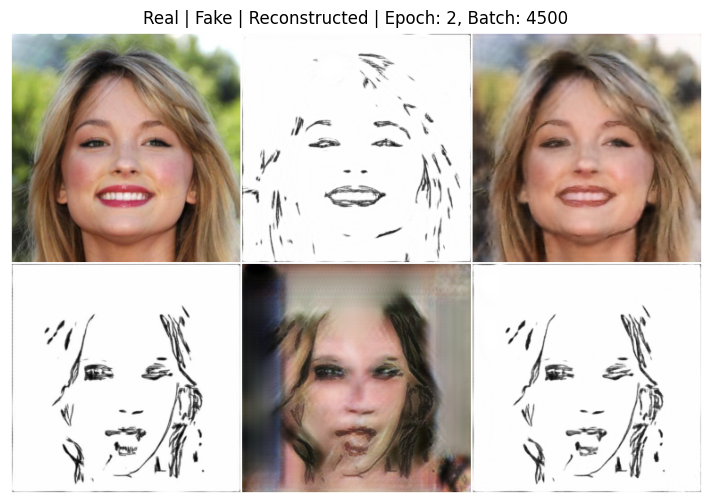

Training Epochs:  40%|████      | 2/5 [2:27:05<3:40:29, 4409.98s/epoch]

Saved checkpoint for epoch 2 to ./checkpoints


[Epoch 3/5] [Batch 1/5164] G_loss: 3.2108 | D_loss: 0.0084


[Epoch 3/5] [Batch 1500/5164] G_loss: 2.8212 | D_loss: 0.0628


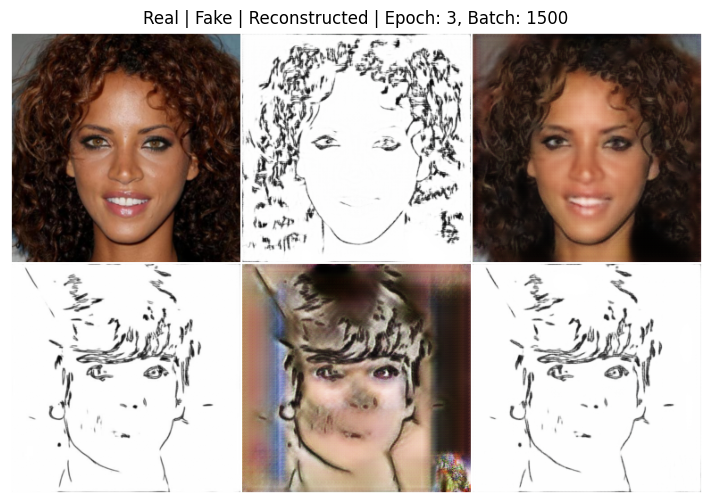

[Epoch 3/5] [Batch 3000/5164] G_loss: 2.8157 | D_loss: 0.0107


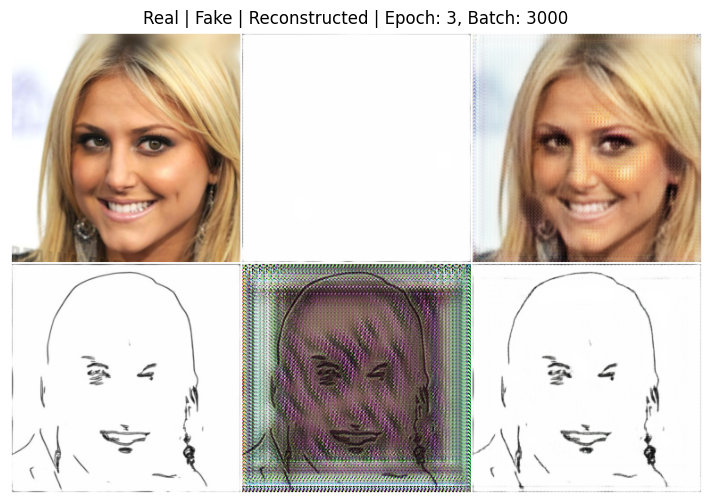

[Epoch 3/5] [Batch 4500/5164] G_loss: 3.1691 | D_loss: 0.0184


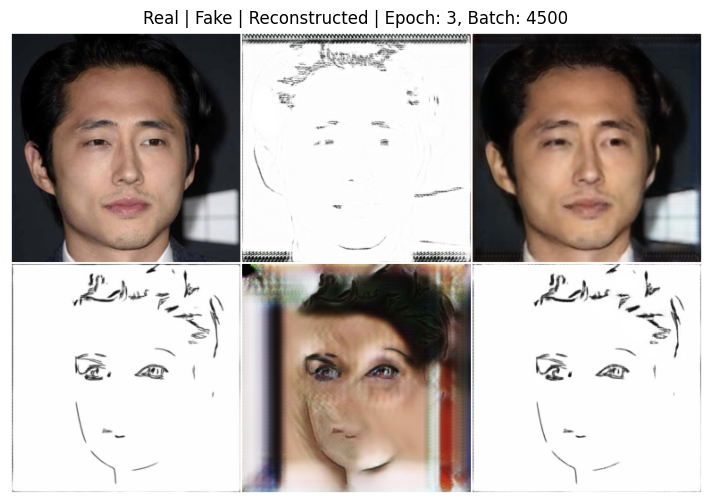

Training Epochs:  60%|██████    | 3/5 [3:34:35<2:21:31, 4245.64s/epoch]

Saved checkpoint for epoch 3 to ./checkpoints


[Epoch 4/5] [Batch 1/5164] G_loss: 3.3843 | D_loss: 0.0122


[Epoch 4/5] [Batch 1500/5164] G_loss: 2.5587 | D_loss: 0.0124


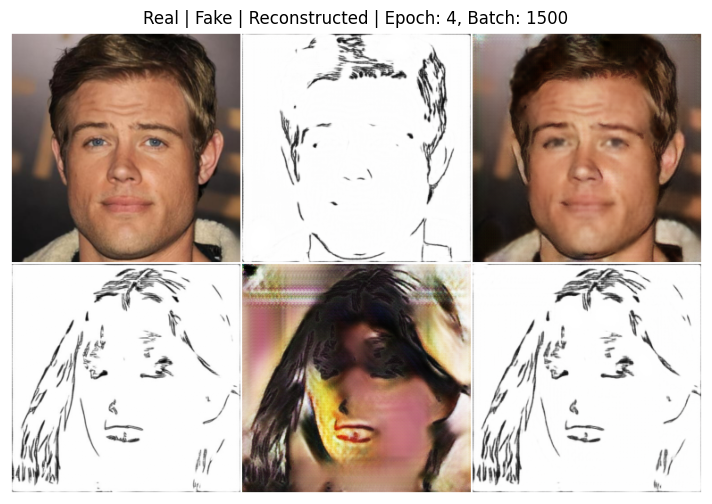

[Epoch 4/5] [Batch 3000/5164] G_loss: 2.9190 | D_loss: 0.0261


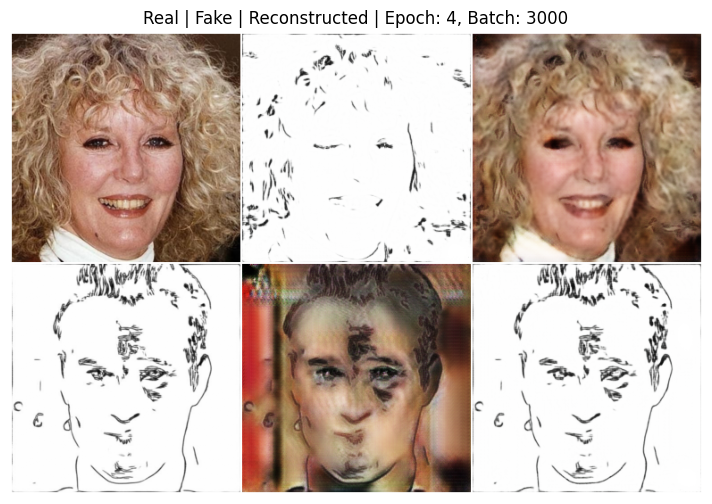

[Epoch 4/5] [Batch 4500/5164] G_loss: 2.9897 | D_loss: 0.0393


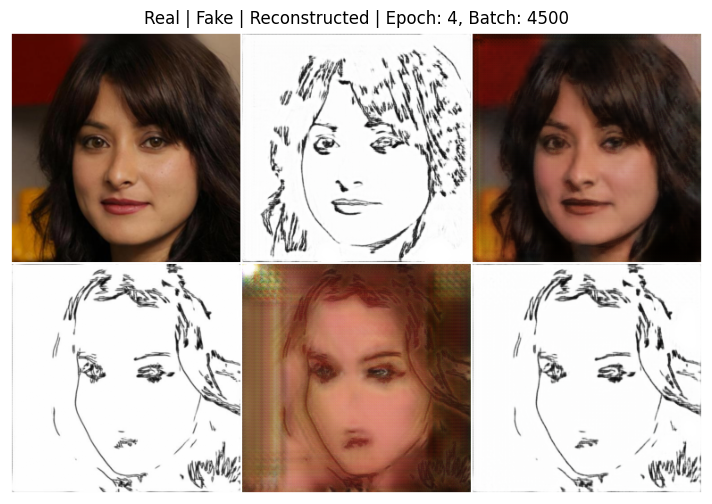

Training Epochs:  80%|████████  | 4/5 [4:47:47<1:11:43, 4303.63s/epoch]

Saved checkpoint for epoch 4 to ./checkpoints


[Epoch 5/5] [Batch 1/5164] G_loss: 3.6353 | D_loss: 0.0164


[Epoch 5/5] [Batch 1500/5164] G_loss: 2.7023 | D_loss: 0.0161


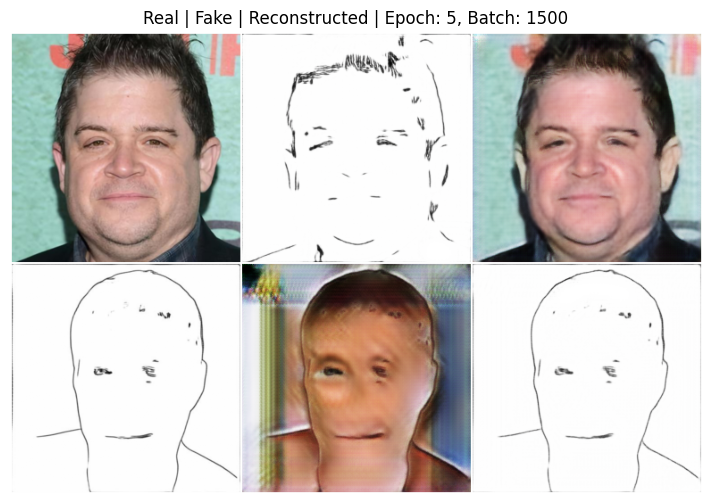

[Epoch 5/5] [Batch 3000/5164] G_loss: 3.6935 | D_loss: 0.0877


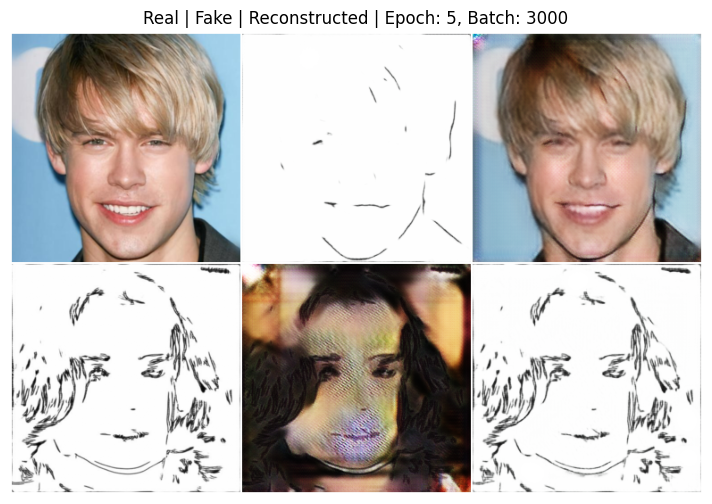

[Epoch 5/5] [Batch 4500/5164] G_loss: 2.8648 | D_loss: 0.0062


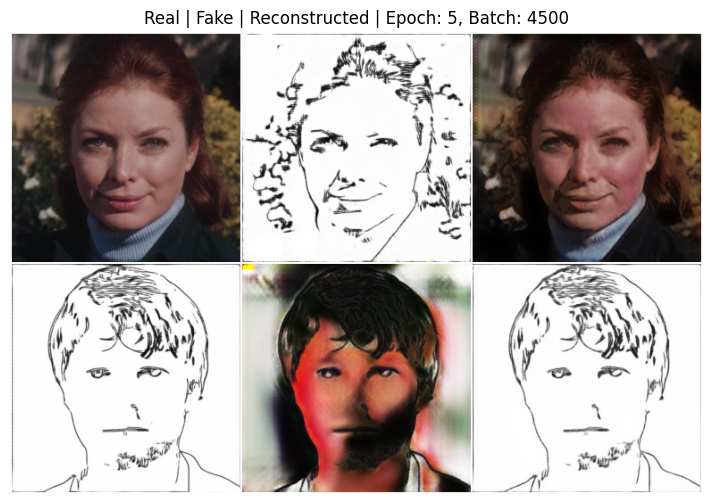

Training Epochs: 100%|██████████| 5/5 [5:53:52<00:00, 4246.53s/epoch]  

Saved checkpoint for epoch 5 to ./checkpoints


In [ ]:
training_loop(model, dataloader, num_epochs = 5  , device=device, ckpt_dir='./checkpoints',
              save_image_every=1, print_every=1500, start_epoch=1)

Training Epochs:   0%|          | 0/10 [00:00<?, ?epoch/s]

[Epoch 11/20] [Batch 1/5164] G_loss: 2.4362 | D_loss: 0.0348


[Epoch 11/20] [Batch 1500/5164] G_loss: 2.4041 | D_loss: 0.0276


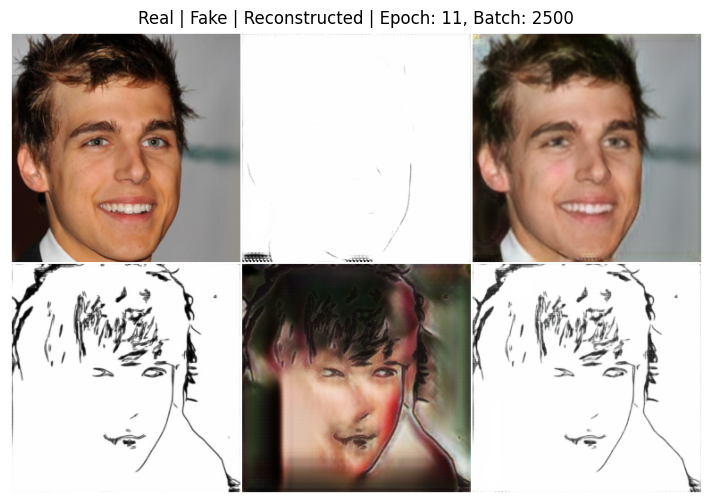

[Epoch 11/20] [Batch 3000/5164] G_loss: 3.1165 | D_loss: 0.0090


[Epoch 11/20] [Batch 4500/5164] G_loss: 2.7195 | D_loss: 0.0122


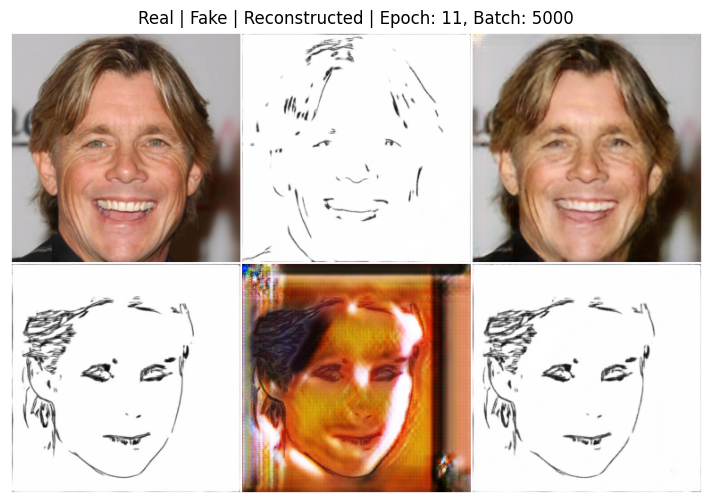

Training Epochs:  10%|█         | 1/10 [1:14:06<11:06:59, 4446.56s/epoch]

Saved checkpoint for epoch 11 to ./checkpoints


[Epoch 12/20] [Batch 1/5164] G_loss: 3.3652 | D_loss: 0.2638


[Epoch 12/20] [Batch 1500/5164] G_loss: 2.8517 | D_loss: 0.0045


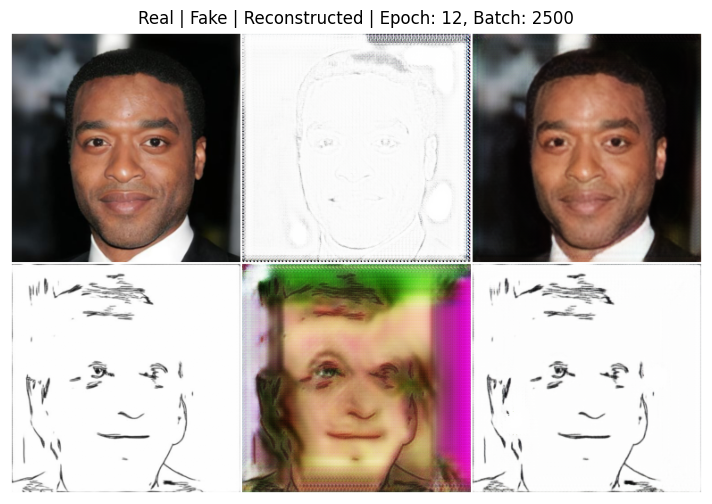

[Epoch 12/20] [Batch 3000/5164] G_loss: 2.5957 | D_loss: 0.0153


[Epoch 12/20] [Batch 4500/5164] G_loss: 2.9075 | D_loss: 0.0062


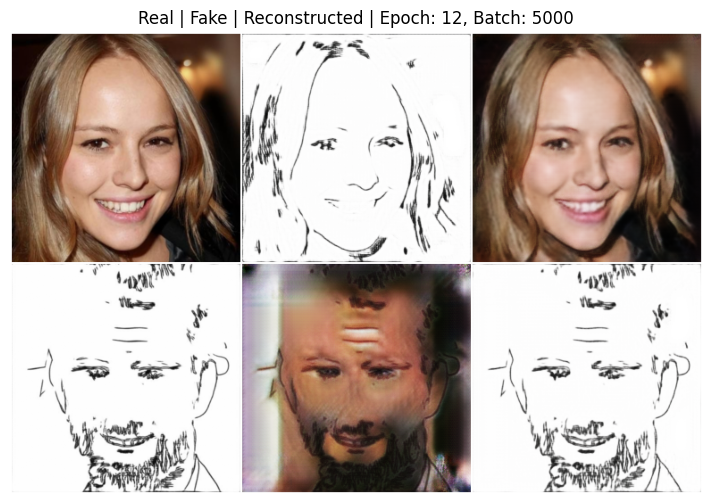

Training Epochs:  20%|██        | 2/10 [2:24:55<9:37:24, 4330.60s/epoch] 

Saved checkpoint for epoch 12 to ./checkpoints


[Epoch 13/20] [Batch 1/5164] G_loss: 2.6827 | D_loss: 0.0128


[Epoch 13/20] [Batch 1500/5164] G_loss: 2.4398 | D_loss: 0.0497


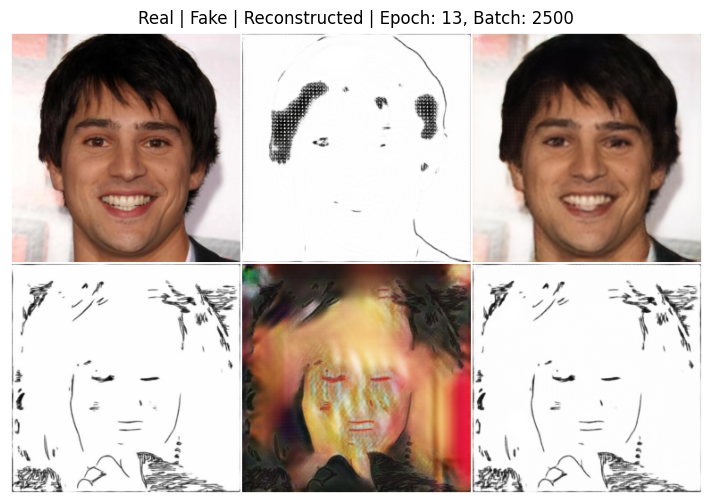

[Epoch 13/20] [Batch 3000/5164] G_loss: 2.7904 | D_loss: 0.0126


[Epoch 13/20] [Batch 4500/5164] G_loss: 2.8501 | D_loss: 0.0164


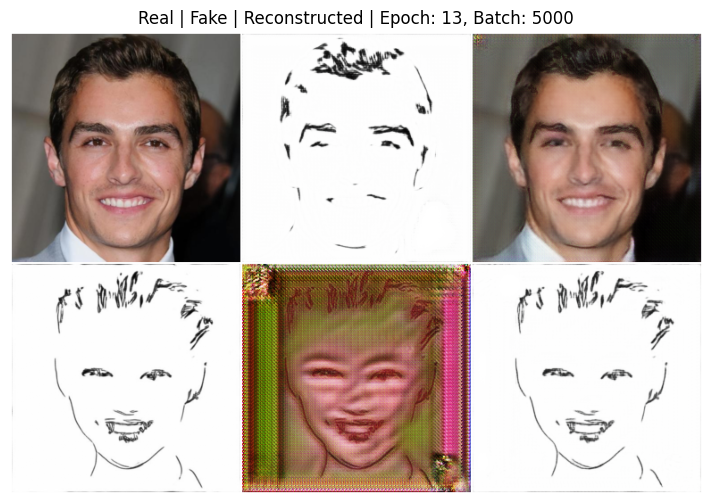

Training Epochs:  30%|███       | 3/10 [3:39:42<8:33:31, 4401.69s/epoch]

Saved checkpoint for epoch 13 to ./checkpoints


[Epoch 14/20] [Batch 1/5164] G_loss: 3.1347 | D_loss: 0.0038


[Epoch 14/20] [Batch 1500/5164] G_loss: 3.2108 | D_loss: 0.0071


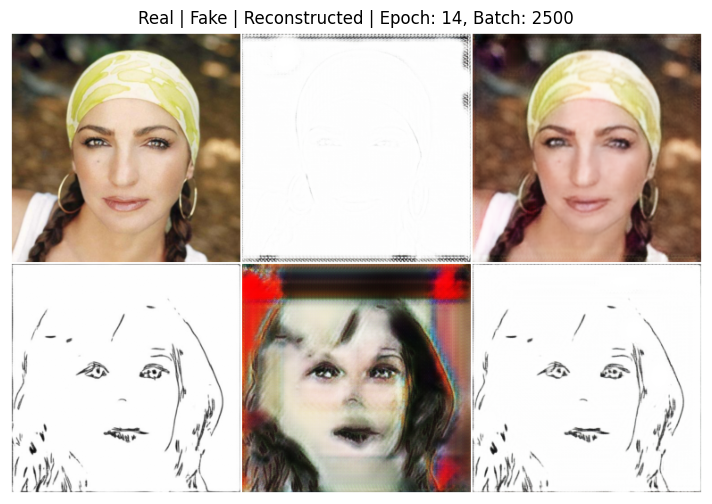

[Epoch 14/20] [Batch 3000/5164] G_loss: 2.8692 | D_loss: 0.0058


[Epoch 14/20] [Batch 4500/5164] G_loss: 2.7672 | D_loss: 0.0029


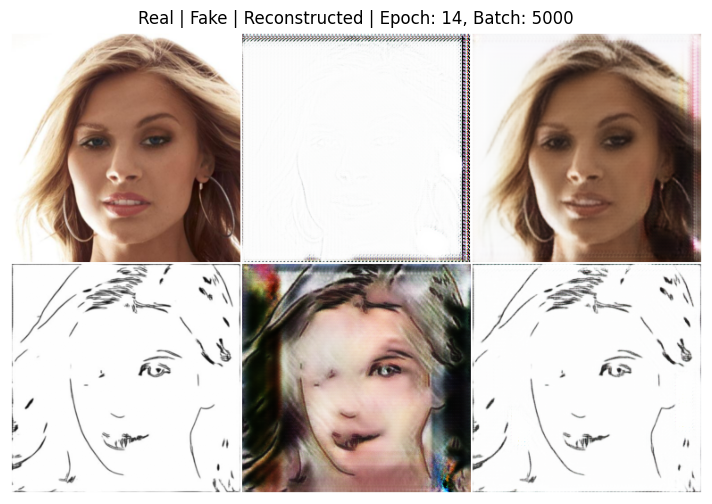

Training Epochs:  40%|████      | 4/10 [4:51:33<7:16:34, 4365.82s/epoch]

Saved checkpoint for epoch 14 to ./checkpoints


[Epoch 15/20] [Batch 1/5164] G_loss: 2.7328 | D_loss: 0.0049


[Epoch 15/20] [Batch 1500/5164] G_loss: 2.3418 | D_loss: 0.0150


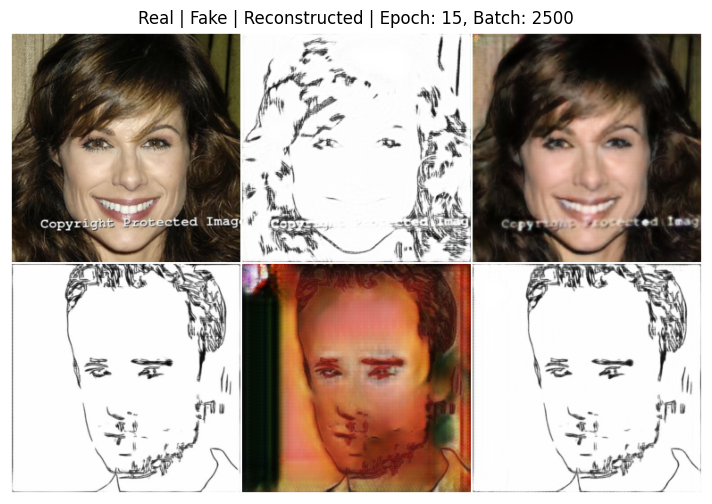

[Epoch 15/20] [Batch 3000/5164] G_loss: 3.4227 | D_loss: 0.0268


[Epoch 15/20] [Batch 4500/5164] G_loss: 2.9174 | D_loss: 0.0229


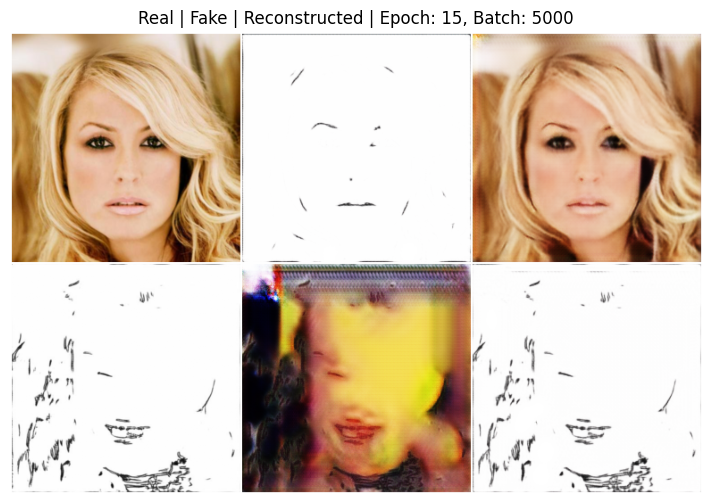

Training Epochs:  50%|█████     | 5/10 [6:16:31<6:25:50, 4630.05s/epoch]

Saved checkpoint for epoch 15 to ./checkpoints


[Epoch 16/20] [Batch 1/5164] G_loss: 2.9187 | D_loss: 0.4241


[Epoch 16/20] [Batch 1500/5164] G_loss: 2.7935 | D_loss: 0.0052


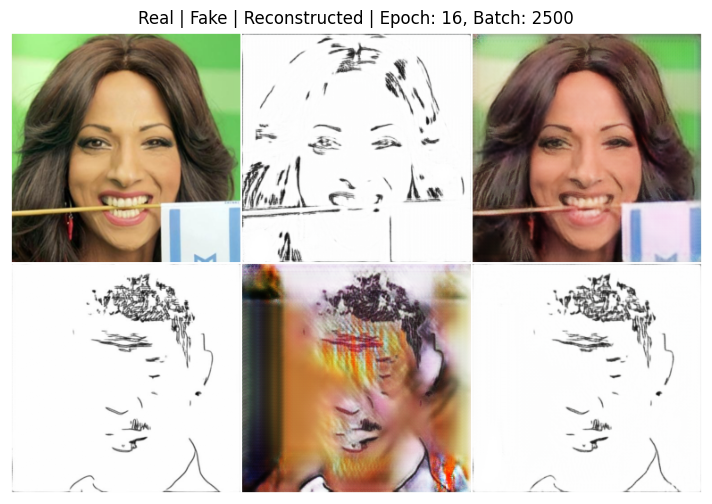

[Epoch 16/20] [Batch 3000/5164] G_loss: 2.4619 | D_loss: 0.0125


[Epoch 16/20] [Batch 4500/5164] G_loss: 2.5730 | D_loss: 0.0129


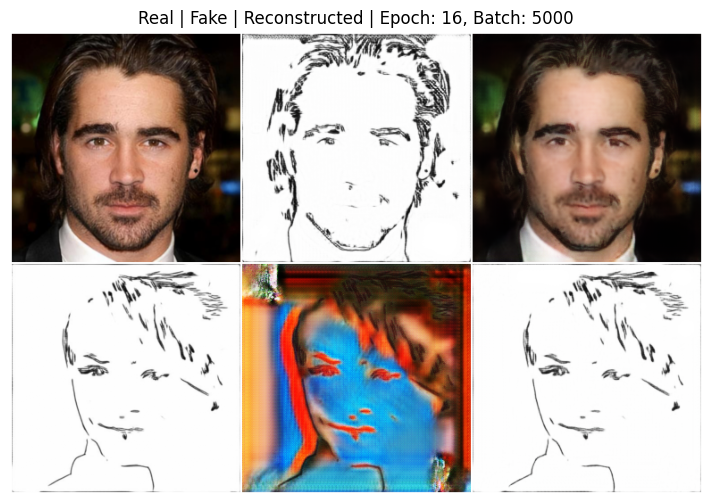

Training Epochs:  60%|██████    | 6/10 [7:35:07<5:10:36, 4659.14s/epoch]

Saved checkpoint for epoch 16 to ./checkpoints


[Epoch 17/20] [Batch 1/5164] G_loss: 2.8090 | D_loss: 0.0060


[Epoch 17/20] [Batch 1500/5164] G_loss: 2.4967 | D_loss: 0.0416


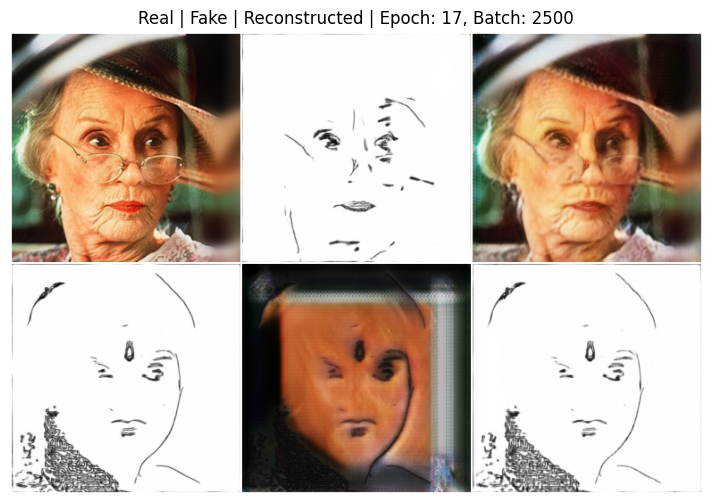

[Epoch 17/20] [Batch 3000/5164] G_loss: 2.0048 | D_loss: 0.1065


[Epoch 17/20] [Batch 4500/5164] G_loss: 3.4534 | D_loss: 0.0628


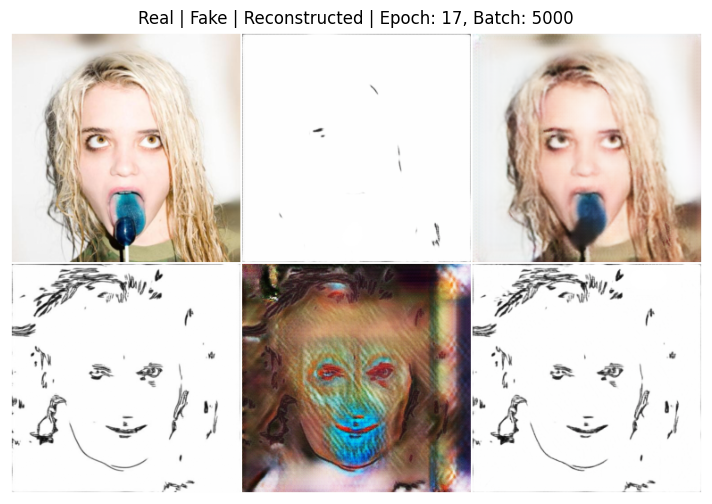

Training Epochs:  70%|███████   | 7/10 [9:39:24<4:38:41, 5573.80s/epoch]

Saved checkpoint for epoch 17 to ./checkpoints


[Epoch 18/20] [Batch 1/5164] G_loss: 2.6514 | D_loss: 0.0028


[Epoch 18/20] [Batch 1500/5164] G_loss: 2.6905 | D_loss: 0.0015


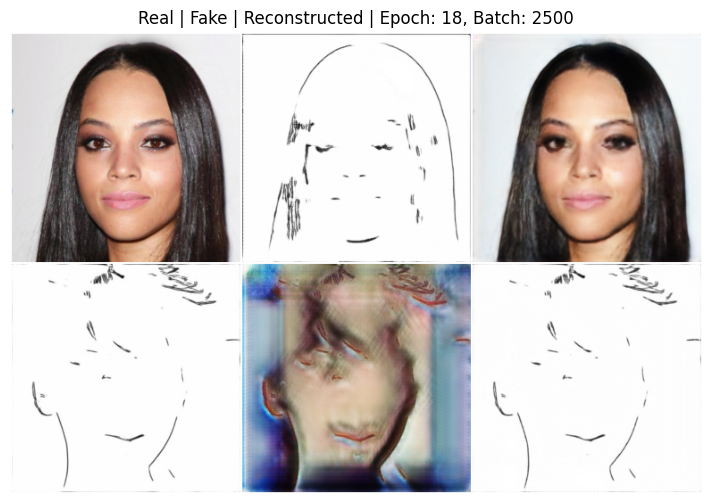

[Epoch 18/20] [Batch 3000/5164] G_loss: 2.8339 | D_loss: 0.0043


[Epoch 18/20] [Batch 4500/5164] G_loss: 2.8606 | D_loss: 0.0041


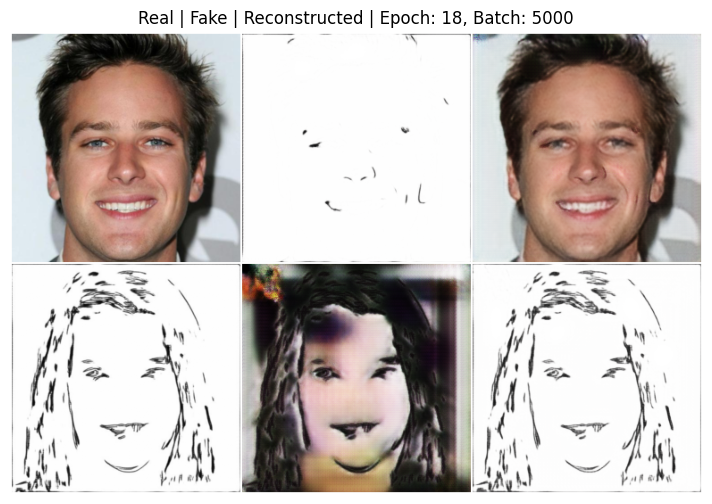

Training Epochs:  80%|████████  | 8/10 [10:50:10<2:51:42, 5151.11s/epoch]

Saved checkpoint for epoch 18 to ./checkpoints


[Epoch 19/20] [Batch 1/5164] G_loss: 2.9104 | D_loss: 0.0046


[Epoch 19/20] [Batch 1500/5164] G_loss: 1.9810 | D_loss: 0.0908


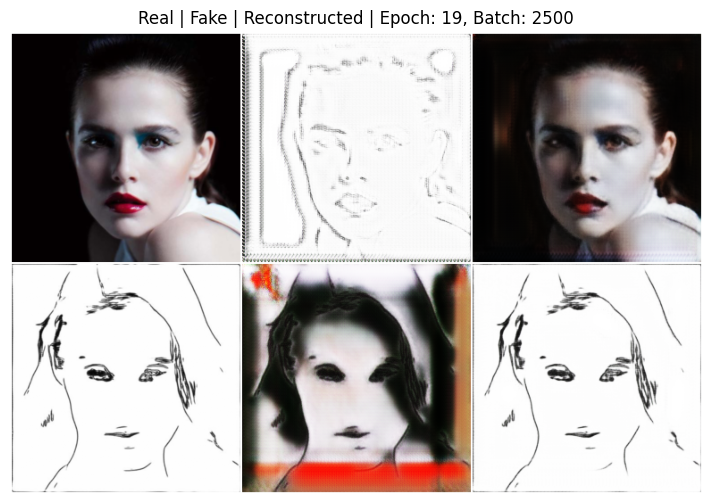

[Epoch 19/20] [Batch 3000/5164] G_loss: 2.7116 | D_loss: 0.0025


[Epoch 19/20] [Batch 4500/5164] G_loss: 2.7283 | D_loss: 0.0014


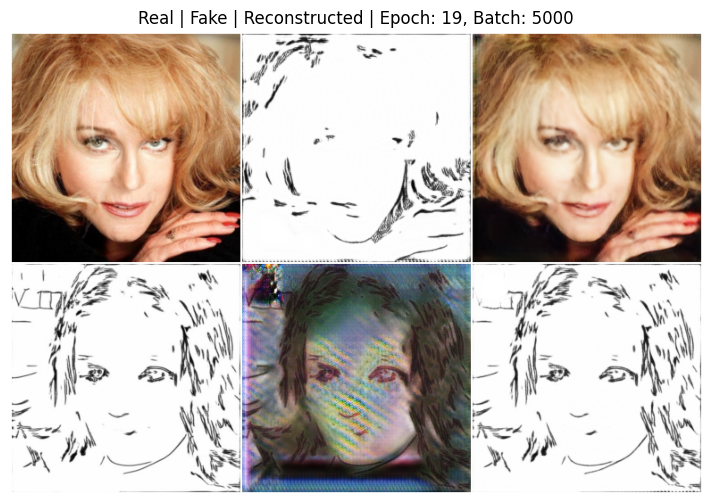

Training Epochs:  90%|█████████ | 9/10 [11:55:57<1:19:34, 4774.62s/epoch]

Saved checkpoint for epoch 19 to ./checkpoints


[Epoch 20/20] [Batch 1/5164] G_loss: 2.6377 | D_loss: 0.0030


[Epoch 20/20] [Batch 1500/5164] G_loss: 2.8144 | D_loss: 0.0065


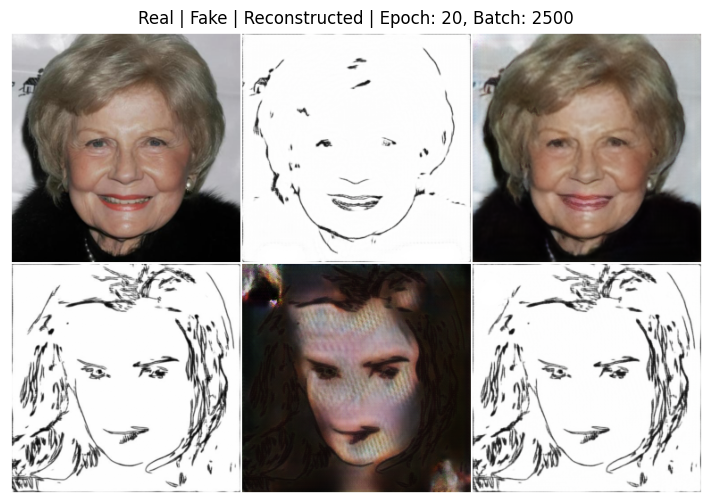

[Epoch 20/20] [Batch 3000/5164] G_loss: 2.6855 | D_loss: 0.1311


[Epoch 20/20] [Batch 4500/5164] G_loss: 2.3514 | D_loss: 0.0802


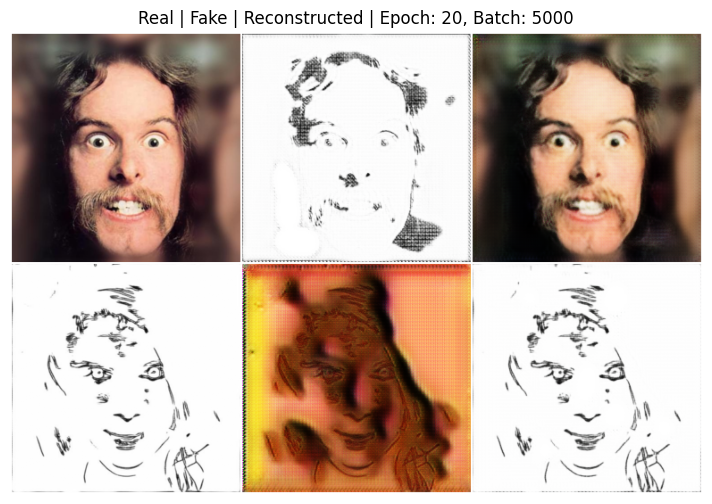

Training Epochs: 100%|██████████| 10/10 [13:01:47<00:00, 4690.77s/epoch] 

Saved checkpoint for epoch 20 to ./checkpoints


In [ ]:
training_loop(model, dataloader, num_epochs = 20  , device=device, ckpt_dir='./checkpoints',
              save_image_every=1, print_every=1500, start_epoch=11)

# LOADING TRAINE MODEL AND SAVING EACH PART SEPARATELY

In [32]:
model = CycleGans(is_train=True).to(device)

In [33]:
load_checkpoint(model, ckpt_path='/home/cowlar/Desktop/junaid/GenAi/cycle_gans_full_architecture.pth')

✅ Loaded full checkpoint from /home/cowlar/Desktop/junaid/GenAi/cycle_gans_full_architecture.pth


In [ ]:
## saving the model parts separately
torch.save(model.G_Anet.state_dict(), 'G_photo_to_sketch.pth')
torch.save(model.G_Bnet.state_dict(), 'G_sketch_to_photo.pth')
torch.save(model.D_Anet.state_dict(), 'D_photo_to_sketch.pth')
torch.save(model.D_Bnet.state_dict(), 'D_sketch_to_photo.pth')

: 